In [35]:
import random
import matplotlib.pyplot as plt
import matplotlib
from matplotlib.patches import Rectangle
import numpy as np
import tensorflow as tf
import tensorflow_hub as hub
import glob as glob
import requests
import zipfile

import os
import cv2

from zipfile import ZipFile
from urllib.request import urlretrieve

from tensorflow.keras import layers
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Dropout, Flatten
from tensorflow.keras.datasets import mnist
from tensorflow.keras.utils import image_dataset_from_directory

from matplotlib.ticker import MultipleLocator, FormatStrFormatter
from tensorflow.keras.datasets import fashion_mnist


from tensorflow.keras.datasets import cifar10
from tensorflow.keras.utils import to_categorical
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter)
from dataclasses import dataclass

In [10]:
import warnings
import logging
import absl

# Filter absl warnings
warnings.filterwarnings("ignore", module="absl")

# Capture all warnings in the logging system
logging.captureWarnings(True)

# Set the absl logger level to 'error' to suppress warnings
absl_logger = logging.getLogger("absl")
absl_logger.setLevel(logging.ERROR)

os.environ["TF_CPP_MIN_LOG_LEVEL"] = "2"

In [3]:
SEED_VALUE = 42

# Fix seed to make training deterministic.
random.seed(SEED_VALUE)
np.random.seed(SEED_VALUE)
tf.random.set_seed(SEED_VALUE)

## Learn How to use Keras for Modeling Linear Regression

### Dataset Exploration

In [3]:
# Load the Boston housing dataset.
(X_train, y_train), (X_test, y_test) = boston_housing.load_data()

print(X_train.shape)
print("\n")
print("Input features: ", X_train[0])
print("\n")
print("Output target: ", y_train[0])

65536/57026 [==================================] - 0s 1us/step
(404, 13)


Input features:  [  1.23247   0.        8.14      0.        0.538     6.142    91.7
   3.9769    4.      307.       21.      396.9      18.72   ]


Output target:  15.2


In [4]:
# Extract features
boston_features = {
    "Average Number of Rooms": 5,
}

X_train_1d = X_train[:, boston_features["Average Number of Rooms"]]
print(X_train_1d.shape)

X_test_1d = X_test[:, boston_features["Average Number of Rooms"]]

(404,)


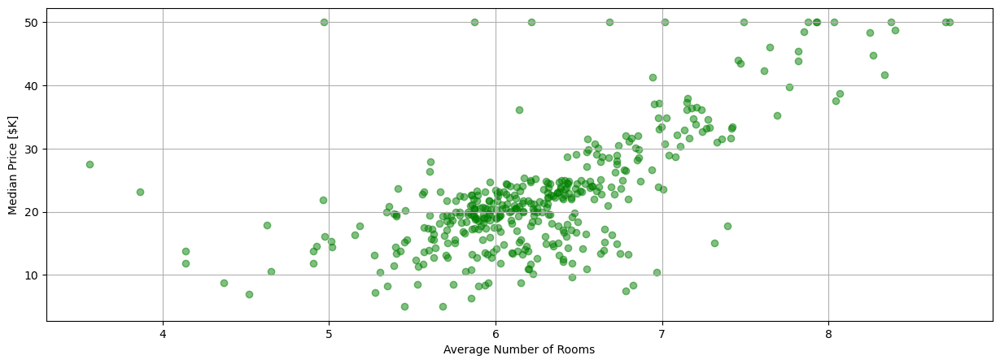

In [7]:
plt.figure(figsize=(15, 5))

plt.xlabel("Average Number of Rooms")
plt.ylabel("Median Price [$K]")
plt.grid("on")
plt.scatter(X_train_1d[:], y_train, color="green", alpha=0.5)

### Model a NN in Keras

In [9]:
# Step 1: Build/Define a network model using predefined layers in Keras.
model = Sequential()

# Define model consist of a single neuron
model.add(Dense(units=1, input_shape=(1,)))

# Display a summary of the model architecture.
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 1)                 2         
Total params: 2
Trainable params: 2
Non-trainable params: 0
_________________________________________________________________


In [11]:
# Step 2: Compile the model with model.compile()
model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.005), loss='mse')

In [36]:
# Step 3: Train the model
history = model.fit(
    X_train_1d,
    y_train,
    batch_size=16,
    epochs=100,
    validation_split=0.3,
)

NameError: name 'model' is not defined

In [14]:
# Step 4: Plot the training results
def plot_loss(history):
    plt.figure(figsize=(20,5))
    plt.plot(history.history['loss'], 'g', label='Training Loss')
    plt.plot(history.history['val_loss'], 'b', label='Validation Loss')
    plt.xlim([0, 100])
    plt.ylim([0, 300])
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)

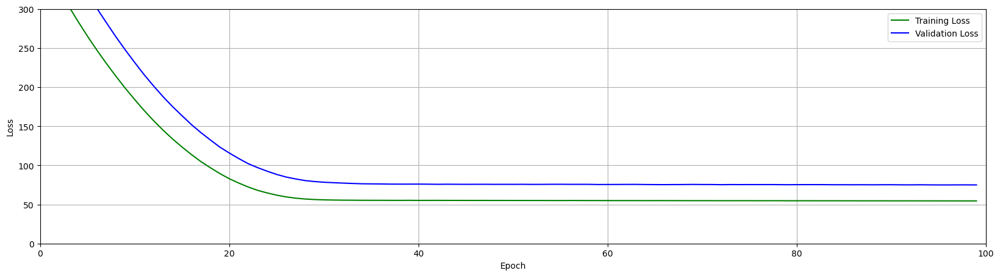

In [15]:
plot_loss(history)

In [16]:
# Optional step: Make prediction using model
x = [3, 4, 5, 6, 7]
y_pred = model.predict(x)
for idx in range(len(x)):
    print(f"Predicted price of a home with {x[idx]} rooms: ${int(y_pred[idx] * 10) / 10}K")

Predicted price of a home with 3 rooms: $11.4K
Predicted price of a home with 4 rooms: $14.7K
Predicted price of a home with 5 rooms: $18.0K
Predicted price of a home with 6 rooms: $21.3K
Predicted price of a home with 7 rooms: $24.7K


In [17]:
# Optional step: Plot the model and data
# Generate feature data that spans the range of interest for the independent variable.
x = np.linspace(3, 9, 10)

# Use the model to predict the dependent variable.
y = model.predict(x)

In [18]:
def plot_data(x_data, y_data, x, y, title=None):
    
    plt.figure(figsize=(15,5))
    plt.scatter(x_data, y_data, label='Ground Truth', color='green', alpha=0.5)
    plt.plot(x, y, color='k', label='Model Predictions')
    plt.xlim([3,9])
    plt.ylim([0,60])
    plt.xlabel('Average Number of Rooms')
    plt.ylabel('Price [$K]')
    plt.title(title)
    plt.grid(True)
    plt.legend()

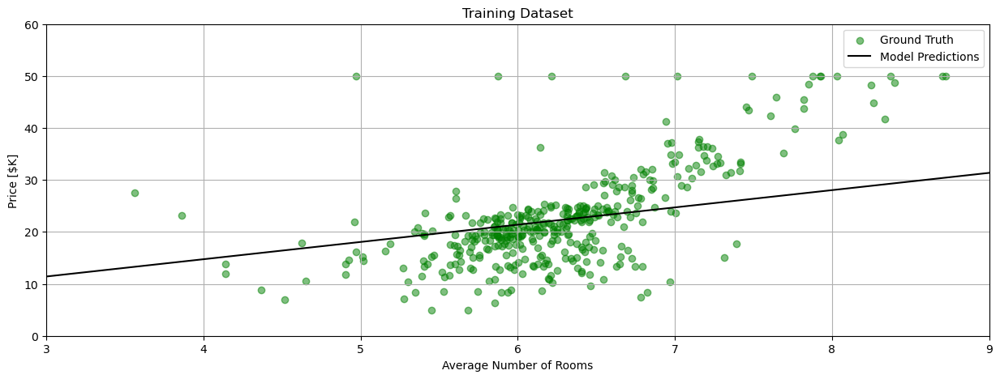

In [19]:
plot_data(X_train_1d, y_train, x, y, title='Training Dataset')

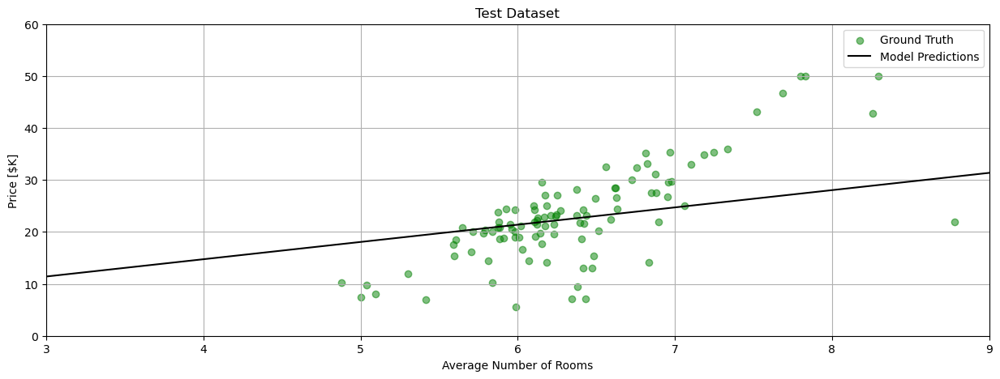

In [20]:
plot_data(X_test_1d, y_test, x, y, title='Test Dataset')

## Image Classification using Feedforward Networks in Keras

In [23]:
plt.rcParams["axes.titlesize"] = 16
plt.rcParams["axes.labelsize"] = 14
plt.rcParams["image.cmap"] = "gray"

In [24]:
SEED_VALUE = 42

# Fix seed to make training deterministic.
random.seed(SEED_VALUE)
np.random.seed(SEED_VALUE)
tf.random.set_seed(SEED_VALUE)

### Load and Split the MNIST Dataset

In [25]:
(X_train_all, y_train_all), (X_test, y_test) = mnist.load_data()

X_valid = X_train_all[:10000]
X_train = X_train_all[10000:]

y_valid = y_train_all[:10000]
y_train = y_train_all[10000:]

print(X_train.shape)
print(X_valid.shape)
print(X_test.shape)

11501568/11490434 [==============================] - 8s 1us/step
(50000, 28, 28)
(10000, 28, 28)
(10000, 28, 28)


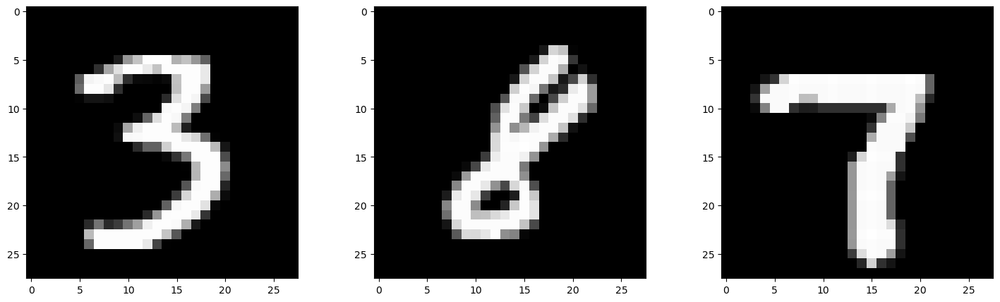

In [26]:
plt.figure(figsize=(18, 5))
for i in range(3):
    plt.subplot(1, 3, i + 1)
    plt.axis(True)
    plt.imshow(X_train[i], cmap="gray")
    plt.subplots_adjust(wspace=0.2, hspace=0.2)

### Dataset Preprocessing

In [27]:
# Step 1: Input Feature Transformation and Normalization
X_train = X_train.reshape((X_train.shape[0], 28 * 28)) # change from (50000, 28, 28) to (50000, 28 * 28)
X_train = X_train.astype("float32") / 255

X_test = X_test.reshape((X_test.shape[0], 28 * 28))
X_test = X_test.astype("float32") / 255

X_valid = X_valid.reshape((X_valid.shape[0], 28 * 28))
X_valid = X_valid.astype("float32") / 255

In [28]:
# Step 2: Label Encoding Options
# Integer label encoding

# Load the Fashion MNIST dataset.
((X_train_fashion, y_train_fashion), (_, _)) = fashion_mnist.load_data()

# The labels in the Fashion MNIST dataset are encoded as integers.
print(y_train_fashion[0:9])


# One-Hot Label Encoding
y_train_onehot = to_categorical(y_train_fashion[0:9])
print(y_train_onehot)

4431872/4422102 [==============================] - 4s 1us/step
[9 0 0 3 0 2 7 2 5]
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]]


In [29]:
# Convert integer labels to one-hot encoded vectors.
y_train = to_categorical(y_train)
y_valid = to_categorical(y_valid)
y_test  = to_categorical(y_test)

## Step 3: Model Architecture
### Deep Neural Network Architecture
The network architecture shown below has multiple layers. An input layer, two hidden layers, and an output layer. There are several things to note about this architecture.

1. `Input Data:` The image input data is pre-processed (flattened) from a 2-Dimensional array [28x28] to 1-Dimensional vector of length [784x1] where the elements in this input vector are the normalized pixel intensities. The input to the network is sometimes referred to as the input "layer", but it's not technically a layer in the network because there are no trainable parameters associated with it.
2. `Hidden Layers:` We have two hidden layers that contain some number of neurons (that we need to specify). Each of the neurons in these layers has a non-linear activation function (e.g., ReLU, Sigmoid, etc...).
3. `Output Layer:` We now have ten neurons in the output layer to represent the ten different classes (digits: 0 to 9), instead of a single neuron as in the regression example.
4. `Dense Layers:` All the layers in the network are fully connected, meaning that each neuron in a given layer is fully connected (or dense) to each of the neurons in the previous layer. The weights associated with each layer are represented in bold to indicate that these are matrices that contain each of the weights for all the connections between adjacent layers in the network.
5. `Softmax Function:` The values from each of the neurons in the output layer are pased through a softmax function to produce a probability score for each of the ten digits in the dataset.

6. `Network Output:` The network output (y') is a vector of length ten, that contains the probabilities of each output neuron. Predicting the class label simply requires passing (y') through the argmax function to determine the index of the predicted label.

7. `Loss Function:` The loss function used is Cross Entropy Loss, which is generally the preferred loss function for classification problems. It is computed from the ground truth labels (y) and the output probabilities of the network (y'). Note that y and y' are both vectors whose length is equal to the number of classes.

Although the diagram looks quite a bit different from the single-layer perceptron in the linear regression example, it is fundamentally very similar in terms of the processing that takes place during training and prediction. We still compute a loss based on the predicted output of the network and the ground truth label of the inputs. Backpropagation is used to compute the gradient of the loss with respect to the weights in the network. An optimizer (which implements gradient descent) is used to update the weights in the neural network.

## Step 4: Model Implementation
Here we use Keras to define the model architecture, which has two dense layers (each with 128 neurons) and a single output layer with 10 neurons. Each neuron in the output layer corresponds to a class label from the dataset (0 through 9) where the output of each represents the probability that the input image corresponds to the class associated with that neuron. For example, if the output from the 5th neuron is .87, then that means the probability that the input image is a 4 is 87% (since the first class is 0, the 5th neuron represents the digit 4).

Notice that the first hidden layer has an input shape of [784,1] since the 28x28 image is flattened to a vector of length 784. The neurons in each of the hidden layers have activation functions called "ReLU" which stands for Rectified Linear Unit. The neurons in the output layer are then passed through a "softmax" function which transforms (normalizes) the raw output, which can be interpreted as a probability as described above.

We will not cover the details of the softmax function or the cross entropy loss function in this post as these are more advanced topics and will be deferred to a post, but briefly, the softmax function normalizes the outputs from the network and converts them to probabilities. The cross-entropy loss function computes a loss between the predicted output probabilities and the ground truth labels. The further the predicted output probabilities are from the target labels the higher the loss.

### 4.1 Define the Model

In [30]:
# Instanitate the model
model = tf.keras.Sequential()

# build the model
model.add(Dense(128, activation='relu', input_shape=(X_train.shape[1],)))
model.add(Dense(128, activation='relu'))
model.add(Dense(10,  activation="softmax"))

# Display the model summary.
model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2 (Dense)              (None, 128)               100480    
_________________________________________________________________
dense_3 (Dense)              (None, 128)               16512     
_________________________________________________________________
dense_4 (Dense)              (None, 10)                1290      
Total params: 118,282
Trainable params: 118,282
Non-trainable params: 0
_________________________________________________________________


### 4.2 Compile the Model
This step defines the optimizer and the loss function that will be used in the training loop. This is also where we can specify any additional metrics to track.

`Optimizer`: Here, we will use the `RMSProp optimizer` in Keras.

`Loss Function:` As mentioned above, the preferred loss function for classification problems is Cross Entropy. But depending on how the labels are encoded we’ll need to specify the proper form of the cross entropy loss function. If the labels are one-hot encoded, then you should specify the loss function as `categorical_crossentropy`, and if the labels are integer encoded, then you should use `sparse_categorical_crossentropy`. When performing binary classification, you should use `binary_crossentropy` as the loss function. Since we are using one-hot encoding in this example, we will specify the loss function as `categorical_crossentropy`.

`Metrics:` Finally, we also specify `accuracy` as an additional metric to record during training so that we can plot it after training is completed. The training loss and validation loss are automatically recorded, so there is no need to specify those.

In [31]:
model.compile(
    optimizer="rmsprop",
    loss="categorical_crossentropy",
    metrics=["accuracy"],
)

### 4.3 Train the Model
To train the model we call the `fit()` method in Keras. Notice that since we split the original training data into train and validation components, we need to explicitly specify the validation dataset using `validation_data=(X_valid, y_valid))`. Recall from an ealier post in this series on linear regression, that we also have the option to use the `validation_split` argument to automatically withhold a random portion of the training data for use as the validation data. So here, we're demonstrating how to explicitly use a separate validation dataset.

In [32]:
training_results = model.fit(X_train, 
                             y_train, 
                             epochs=21, 
                             batch_size=64, 
                             validation_data=(X_valid, y_valid));

Epoch 1/21
782/782 [==============================] - 2s 2ms/step - loss: 0.2781 - accuracy: 0.9181 - val_loss: 0.1802 - val_accuracy: 0.9413
Epoch 2/21
782/782 [==============================] - 2s 2ms/step - loss: 0.1167 - accuracy: 0.9655 - val_loss: 0.1193 - val_accuracy: 0.9649
Epoch 3/21
782/782 [==============================] - 2s 2ms/step - loss: 0.0833 - accuracy: 0.9747 - val_loss: 0.1252 - val_accuracy: 0.9627
Epoch 4/21
782/782 [==============================] - 2s 2ms/step - loss: 0.0643 - accuracy: 0.9799 - val_loss: 0.0919 - val_accuracy: 0.9730
Epoch 5/21
782/782 [==============================] - 2s 2ms/step - loss: 0.0514 - accuracy: 0.9836 - val_loss: 0.0989 - val_accuracy: 0.9732
Epoch 6/21
782/782 [==============================] - 2s 2ms/step - loss: 0.0424 - accuracy: 0.9873 - val_loss: 0.0864 - val_accuracy: 0.9782
Epoch 7/21
782/782 [==============================] - 2s 2ms/step - loss: 0.0345 - accuracy: 0.9897 - val_loss: 0.0912 - val_accuracy: 0.9750
Epoch 

### 4.4 Plot the Training Results
The function below is a convenience function to plot training and validation losses and training and validation accuracies. It has a single required argument which is a list of metrics to plot.

In [33]:
def plot_results(metrics, title=None, ylabel=None, ylim=None, metric_name=None, color=None):
    
    fig, ax = plt.subplots(figsize=(15, 4))

    if not (isinstance(metric_name, list) or isinstance(metric_name, tuple)):
        metrics = [metrics,]
        metric_name = [metric_name,]
        
    for idx, metric in enumerate(metrics):    
        ax.plot(metric, color=color[idx])
    
    plt.xlabel("Epoch")
    plt.ylabel(ylabel)
    plt.title(title)
    plt.xlim([0, 20])
    plt.ylim(ylim)
    # Tailor x-axis tick marks
    ax.xaxis.set_major_locator(MultipleLocator(5))
    ax.xaxis.set_major_formatter(FormatStrFormatter('%d'))
    ax.xaxis.set_minor_locator(MultipleLocator(1))
    plt.grid(True)
    plt.legend(metric_name)   
    plt.show()
    plt.close()

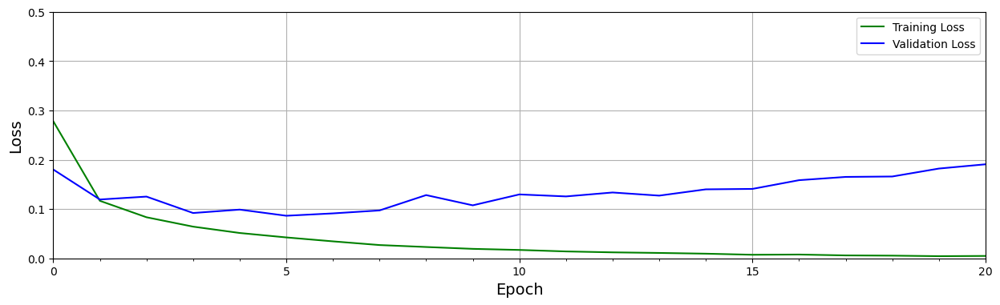

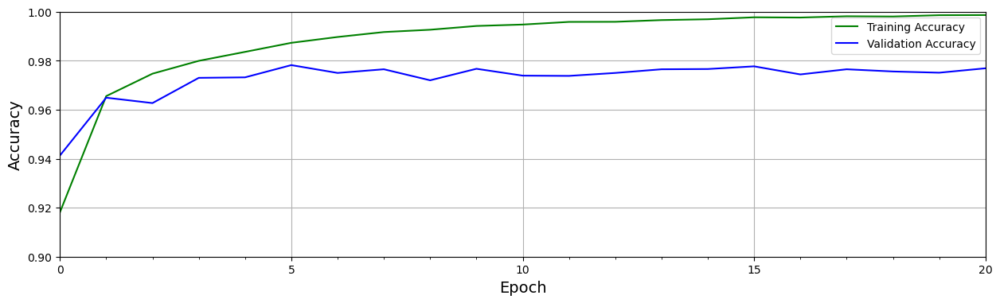

In [34]:
# Retrieve training results.
train_loss = training_results.history["loss"]
train_acc  = training_results.history["accuracy"]
valid_loss = training_results.history["val_loss"]
valid_acc  = training_results.history["val_accuracy"]

plot_results(
    [train_loss, valid_loss],
    ylabel="Loss",
    ylim=[0.0, 0.5],
    metric_name=["Training Loss", "Validation Loss"],
    color=["g", "b"],
)

plot_results(
    [train_acc, valid_acc],
    ylabel="Accuracy",
    ylim=[0.9, 1.0],
    metric_name=["Training Accuracy", "Validation Accuracy"],
    color=["g", "b"],
)

## 5 Model Evaluation
### 5.1 Make Predictions on Sample Test Images
We can now predict the results for all the test images, as shown in the code below. Here, we call the predict() method to retrieve all the predictions, and then we select a specific index from the test set and print out the predicted scores for each class. You can experiment with the code below by setting the test index to various values and see how the highest score is usually associated with the correct value indicated by the ground truth.

In [35]:
predictions = model.predict(X_test)
index = 0  # up to 9999
print("Ground truth for test digit: ", y_test[index])
print("\n")
print("Predictions for each class:\n")
for i in range(10):
    print("digit:", i, " probability: ", predictions[index][i])

Ground truth for test digit:  [0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]


Predictions for each class:

digit: 0  probability:  3.8816733e-22
digit: 1  probability:  1.4480825e-28
digit: 2  probability:  2.4971178e-17
digit: 3  probability:  4.128445e-21
digit: 4  probability:  3.4159727e-30
digit: 5  probability:  3.9615364e-24
digit: 6  probability:  0.0
digit: 7  probability:  1.0
digit: 8  probability:  8.00802e-24
digit: 9  probability:  2.956905e-18


### 5.2 Confusion Matrix
A confusion matrix is a very common metric that is used to summarize the results of a classification problem. The information is presented in the form of a table or matrix where one axis represents the ground truth labels for each class, and the other axis represents the predicted lables from the network. The entries in the table represent the number of instances from an experiment (which are sometimes represented as percentages rather than counts). Generating a confusion matrix in TensorFlow is accomplished by calling the function `tf.math.confusion_matrix()`, which takes two required arguments which are the list of ground truth labels and the associated predicted lables.

In [36]:
# Generate predictions for the test dataset.
predictions = model.predict(X_test)

# For each sample image in the test dataset, select the class label with the highest probability.
predicted_labels = [np.argmax(i) for i in predictions]

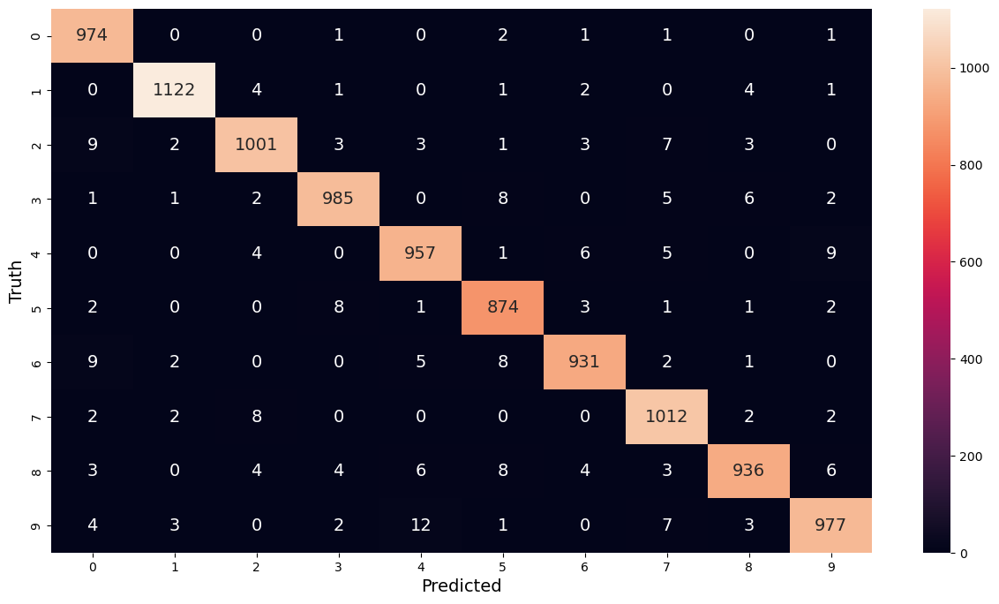

In [37]:
# Convert one-hot encoded labels to integers.
y_test_integer_labels = tf.argmax(y_test, axis=1)

# Generate a confusion matrix for the test dataset.
cm = tf.math.confusion_matrix(labels=y_test_integer_labels, predictions=predicted_labels)

# Plot the confusion matrix as a heatmap.
plt.figure(figsize=[15, 8])
import seaborn as sn

sn.heatmap(cm, annot=True, fmt="d", annot_kws={"size": 14})
plt.xlabel("Predicted")
plt.ylabel("Truth")
plt.show()

# CNN

## Implementing a CNN in TensorFlow and Keras
In this notebook, we’ll learn how to implement a Convolutional Neural Network (CNN) from scratch using Keras. Here, we show a CNN architecture similar to the structure of VGG-16 but with fewer layers. We will learn how to model this architecture and train it on a small dataset called CIFAR-10. We’ll also use this as an opportunity to introduce a new layer type called Dropout, which is often used in models to mitigate the effects of overfitting.

In [39]:
SEED_VALUE = 42

# Fix seed to make training deterministic.
random.seed(SEED_VALUE)
np.random.seed(SEED_VALUE)
tf.random.set_seed(SEED_VALUE)

### 1. Load the CIFAR-10 Dataset
The CIFAR-10 dataset consists of 60,000 color images from 10 classes, with 6,000 images per class. There are 50,000 training images and 10,000 test images. Several sample images are shown below, along with the class names.


The CIFAR-10 dataset is included in TensorFlow, so we can load the dataset using the load_data() function as shown in the code cell below and confirm the number of samples and the shape of the data.

In [40]:
(X_train, y_train), (X_test, y_test) = cifar10.load_data()

print(X_train.shape)
print(X_test.shape)

170508288/170498071 [==============================] - 267s 2us/step
(50000, 32, 32, 3)
(10000, 32, 32, 3)


### 1.1 Display Sample Images from the Dataset

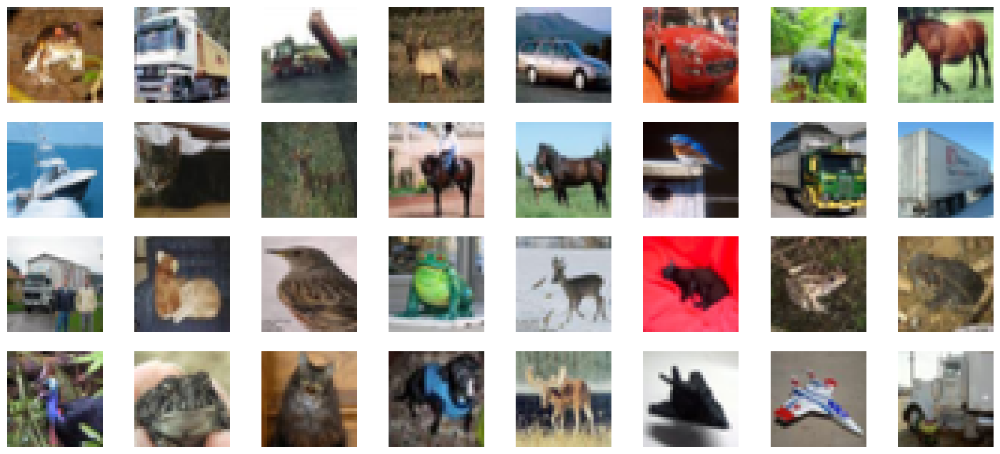

In [41]:
plt.figure(figsize=(18, 8))

num_rows = 4
num_cols = 8

# plot each of the images in the batch and the associated ground truth labels.
for i in range(num_rows * num_cols):
    ax = plt.subplot(num_rows, num_cols, i + 1)
    plt.imshow(X_train[i, :, :])
    plt.axis("off")

### 2. Dataset Preprocessing
Here, we normalize the image data to the range [0,1]. This is very common when working with image data which helps the model train more efficiently. We also convert the integer labels to one-hot encoded labels, as discussed in previous videos.

In [42]:
# Normalize images to range [0,1]
X_train = X_train.astype("float32") / 255
X_test = X_test.astype("float32") / 255

# Change the labels from integer to categorical data.
print('Original (integer) label for the first training sample: ', y_train[0])

# Convert from label to one-hot encoded
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)

print('After conversion to categorical one-hot encoded labels: ', y_train[0])

Original (integer) label for the first training sample:  [6]
After conversion to categorical one-hot encoded labels:  [0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]


### 3. Dataset and Training Configuration Parameters
Before we describe the model implementation and training, we’re going to apply a little more structure to our training process by using the `dataclasses` module in python to create simple `DatasetConfig` and `TrainingConfig` classes to organize several data and training configuration parameters. This allows us to create data structures for configuration parameters, as shown below. The benefit of doing this is that we have a single place to go to make any desired changes.

In [43]:
@dataclass(frozen=True)
class DatasetConfig:
    NUM_CLASSES:  int = 10
    IMG_HEIGHT:   int = 32
    IMG_WIDTH:    int = 32
    NUM_CHANNELS: int = 3
    
@dataclass(frozen=True)
class TrainingConfig:
    EPOCHS:        int = 31
    BATCH_SIZE:    int = 256
    LEARNING_RATE: float = 0.001 

## 4 CNN Model Implementation in Keras
In this section, we will define a simple CNN model in Keras and train it on the CIRFAR-10 dataset. Recall from a previous notebook the following steps required to define and train a model in Keras.

1. Build/Define a network model using predefined layers in Keras
2. Compile the model with `model.compile()`
3. Train the model with `model.fit()`

### 4.1 Model Structure
Before we get into the coding details, let’s first take a look at the general structure of the model we’re proposing. Notice that the model has a similar structure to VGG-16 but has fewer layers and a much smaller input image size, and therefore far fewer trainable parameters. The model contains three convolutional blocks followed by a fully connected layer and an output layer. For reference, we’ve included the number of channels at key points in the architecture. We have also indicated the spatial size of the activation maps at the end of each convolutional block. This is a good visual to refer back to when studying the code below.
For convenience, we’re going to define the model in a function. Notice that the function has one optional argument: the input shape for the model. We first start by instantiating the model by calling the sequential() method. This allows us to build a model sequentially by adding one layer at a time. Noticed that we define three convolutional blocks and that their structure is very similar.

### 4.2 Define the Convolutional Blocks
Let’s start with the very first convolutional layer in the first convolutional block. To define a convolutional layer in Keras, we call the Conv2D() function, which takes several input arguments. First, we defined the layer to have 32 filters. The kernel size for each filter is 3 (which is interpreted as 3x3). We use a padding option called same, which will pad the input tensor so that the output of the convolution operation has the same spatial size as the input. This is not required, but it’s commonly used. if you don’t explicitly specify this padding option, then the default behavior has no padding, and therefore, the spatial size of output from the convolutional layer will be slightly smaller than the input size. We use a ReLU activation function in all the layers in the Network except for the output layer.

For the very first convolutional layer, we need to specify the shape of the input, but for all subsequent layers, this is not necessary since the shape of the input is automatically computed based on the shape of the output from previous layers, so we have two convolutional layers with 32 filters each, and then we follow that with a max pooling layer that has a window size of (2x2), so the output shape from this first convolution block is (16x16 x32). Next, we have the second convolutional block, which is nearly identical to the first, with the exception that we have 64 filters in each convolutional layer instead of 32, and then finally, the third convolutional block is an exact copy of the second convolutional block.

`Note:` The number of filters in each convolutional layer is something that you will need to experiment with. A larger number of filters allows the model to have a greater learning capacity, but this also needs to be balanced with the amount of data available to train the model. Adding too many filters (or layers) can lead to overfitting, one of the most common issues encountered when training models.

In [47]:
def cnn_model(input_shape=(32,32,3)):
    
    model = Sequential()
    
    # Conv Block 1: 32 filter, MaxPool
    # Input of first layer in CNN is input of image
    model.add(Conv2D(filters=32, kernel_size=3, padding='same', activation='relu', input_shape=input_shape))
    model.add(Conv2D(filters=32, kernel_size=3, padding='same', activation='relu'))
    model.add(MaxPooling2D(pool_size=(2,2)))
    
    # Conv Block 2: 64 filter, MaxPool
    model.add(Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'))
    model.add(Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'))
    model.add(MaxPooling2D(pool_size=(2,2)))

    # Conv Block 3: 64 filter, MaxPool
    model.add(Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'))
    model.add(Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'))
    model.add(MaxPooling2D(pool_size=(2,2)))

    # Flatten the conv features
    model.add(Flatten())
    model.add(Dense(512, activation='relu'))
    model.add(Dense(10, activation='softmax')) # Because our dataset has 10 classes
    
    return model

### 4.3 Define the Classifier
Before we define the fully connected layers for the classifier, we need to first flatten the two-dimensional activation maps that are produced by the last convolutional layer (which have a spatial shape of 4x4 with 64 channels). This is accomplished by calling the flatten() function to create a 1-dimensional vector of length 1024. We then add a densely connected layer with 512 neurons and a fully connected output layer with ten neurons because we have ten classes in our dataset. And to avoid any confusion, we’ve also provided a detailed diagram of the fully connected layers.

### 4.4 Create the Model
We can now create an instance of the model by calling the function above and use the summary() method to display the model summary to the console.

In [48]:
# Create the model.
model = cnn_model()
model.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_4 (Conv2D)            (None, 32, 32, 32)        896       
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 32, 32, 32)        9248      
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 16, 16, 32)        0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 16, 16, 64)        18496     
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 16, 16, 64)        36928     
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 8, 8, 64)          0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 8, 8, 64)         

### 4.5 Compile the Model
The next step is to compile the model, where we specify the optimizer type and loss function and any additional metrics we would like recorded during training. Here we specify RMSProp as the optimizer type for gradient descent, and we use a cross-entropy loss function which is the standard loss function for classification problems. We specifically use categorical_crossentropy since our labels are one-hot encoded. Finally, we specify accuracy as an additional metric to record during training. The value of the loss function is always recorded by default, but if you want accuracy, you need to specify it.

In [49]:
model.compile(
    optimizer="rmsprop",
    loss="categorical_crossentropy", # For hot-encoded
    metrics=["accuracy"],
)

### 4.6 Train the Model
Since the dataset does not include a validation dataset, and since we did not previously split the training dataset to create a validation dataset, we will use the validation_split argument below so that 30% of the training dataset is automatically reserved for validation. This approach reserves the last 30% of the dataset for training. This is a very convenient approach, but if the training dataset has any specific ordering (say, ordered by classes), you will need to take steps to randomize the order before splitting.

In [50]:
history = model.fit(X_train, 
                    y_train,
                    batch_size=TrainingConfig.BATCH_SIZE,
                    epochs=TrainingConfig.EPOCHS,
                    verbose=1,
                    validation_split=0.3,
                   )

Epoch 1/31
137/137 [==============================] - 13s 37ms/step - loss: 2.1204 - accuracy: 0.2355 - val_loss: 1.7757 - val_accuracy: 0.3659
Epoch 2/31
137/137 [==============================] - 4s 30ms/step - loss: 1.6748 - accuracy: 0.3896 - val_loss: 1.4792 - val_accuracy: 0.4536
Epoch 3/31
137/137 [==============================] - 4s 29ms/step - loss: 1.4253 - accuracy: 0.4889 - val_loss: 1.3576 - val_accuracy: 0.5148
Epoch 4/31
137/137 [==============================] - 4s 30ms/step - loss: 1.2437 - accuracy: 0.5571 - val_loss: 1.1301 - val_accuracy: 0.5995
Epoch 5/31
137/137 [==============================] - 4s 30ms/step - loss: 1.0941 - accuracy: 0.6133 - val_loss: 1.1196 - val_accuracy: 0.6093
Epoch 6/31
137/137 [==============================] - 5s 33ms/step - loss: 0.9610 - accuracy: 0.6633 - val_loss: 0.9225 - val_accuracy: 0.6817
Epoch 7/31
137/137 [==============================] - 4s 30ms/step - loss: 0.8534 - accuracy: 0.7021 - val_loss: 0.8939 - val_accuracy: 0.689

### 4.7 Plot the Training Results

In [51]:
def plot_results(metrics, title=None, ylabel=None, ylim=None, metric_name=None, color=None):
    fig, ax = plt.subplots(figsize=(15, 4))

    if not (isinstance(metric_name, list) or isinstance(metric_name, tuple)):
        metrics = [metrics,]
        metric_name = [metric_name,]

    for idx, metric in enumerate(metrics):
        ax.plot(metric, color=color[idx])

    plt.xlabel("Epoch")
    plt.ylabel(ylabel)
    plt.title(title)
    plt.xlim([0, TrainingConfig.EPOCHS - 1])
    plt.ylim(ylim)
    # Tailor x-axis tick marks
    ax.xaxis.set_major_locator(MultipleLocator(5))
    ax.xaxis.set_major_formatter(FormatStrFormatter("%d"))
    ax.xaxis.set_minor_locator(MultipleLocator(1))
    plt.grid(True)
    plt.legend(metric_name)
    plt.show()
    plt.close()

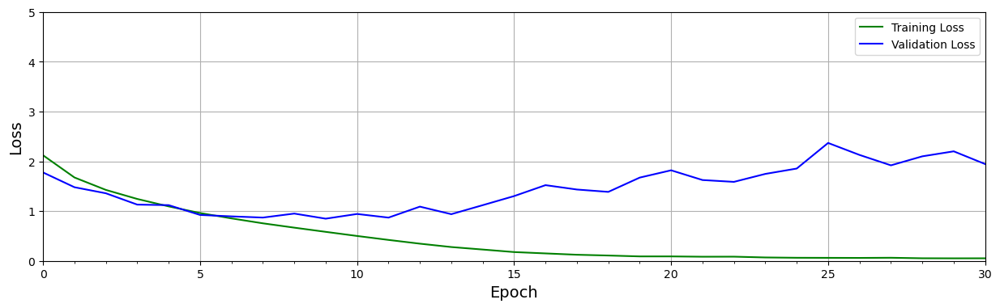

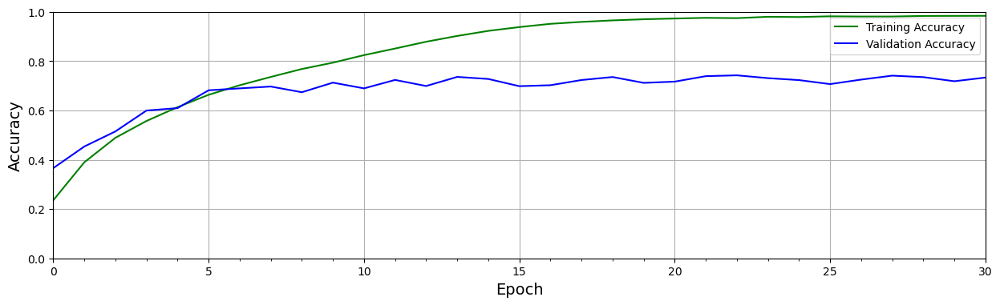

In [52]:
# Retrieve training results.
train_loss = history.history["loss"]
train_acc  = history.history["accuracy"]
valid_loss = history.history["val_loss"]
valid_acc  = history.history["val_accuracy"]

plot_results(
    [train_loss, valid_loss],
    ylabel="Loss",
    ylim=[0.0, 5.0],
    metric_name=["Training Loss", "Validation Loss"],
    color=["g", "b"],
)

plot_results(
    [train_acc, valid_acc],
    ylabel="Accuracy",
    ylim=[0.0, 1.0],
    metric_name=["Training Accuracy", "Validation Accuracy"],
    color=["g", "b"],
)

The results from our baseline model reveal that the model is overfitting. Notice that the validation loss increases after about ten epochs of training while the training loss continues to decline. This means that the network learns how to model the training data well but does not generalize to unseen test data well. The accuracy plot shows a similar trend where the validation accuracy levels off after about ten epochs while the training accuracy continues to approach 100% as training progresses. This is a common problem when training neural networks and can occur for a number of reasons. One reason is that the model can fit the nuances of the training dataset, especially when the training dataset is small.

## 5. Adding Dropout to the Model
To help mitigate this problem, we can employ one or more regularization strategies to help the model generalize better. Regularization techniques help to restrict the model's flexibility so that it doesn't overfit the training data. One approach is called Dropout, which is built into Keras. Dropout is implemented in Keras as a special layer type that randomly drops a percentage of neurons during the training process. When dropout is used in convolutional layers, it is usually used after the max pooling layer and has the effect of eliminating a percentage of neurons in the feature maps. When used after a fully connected layer, a percentage of neurons in the fully connected layer are dropped.
### 5.1 Define the Model (with Dropout)

In [53]:
def cnn_model_dropout(input_shape=(32, 32, 3)):
    
    model = Sequential()
    
    #------------------------------------
    # Conv Block 1: 32 Filters, MaxPool.
    #------------------------------------
    model.add(Conv2D(filters=32, kernel_size=3, padding='same', activation='relu', input_shape=input_shape))
    model.add(Conv2D(filters=32, kernel_size=3, padding='same', activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))

    #------------------------------------
    # Conv Block 2: 64 Filters, MaxPool.
    #------------------------------------
    model.add(Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'))
    model.add(Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))

    #------------------------------------
    # Conv Block 3: 64 Filters, MaxPool.
    #------------------------------------
    model.add(Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'))
    model.add(Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    
    #------------------------------------
    # Flatten the convolutional features.
    #------------------------------------
    model.add(Flatten())
    model.add(Dense(512, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(10, activation='softmax'))
    
    return model

### 5.2 Create the Model (with Dropout)

In [54]:
# Create the model.
model_dropout = cnn_model_dropout()
model_dropout.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_10 (Conv2D)           (None, 32, 32, 32)        896       
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 32, 32, 32)        9248      
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 16, 16, 32)        0         
_________________________________________________________________
dropout (Dropout)            (None, 16, 16, 32)        0         
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 16, 16, 64)        18496     
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 16, 16, 64)        36928     
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 8, 8, 64)         

In [55]:
# Compile
model_dropout.compile(
    optimizer="rmsprop",
    loss="categorical_crossentropy",
    metrics=["accuracy"],
)

In [56]:
# Train
history = model_dropout.fit(X_train,
                            y_train,
                            batch_size=TrainingConfig.BATCH_SIZE, 
                            epochs=TrainingConfig.EPOCHS, 
                            verbose=1, 
                            validation_split=.3,
                           )

Epoch 1/31
137/137 [==============================] - 5s 35ms/step - loss: 2.1458 - accuracy: 0.2141 - val_loss: 1.9374 - val_accuracy: 0.3215
Epoch 2/31
137/137 [==============================] - 4s 31ms/step - loss: 1.7569 - accuracy: 0.3658 - val_loss: 1.7230 - val_accuracy: 0.4121
Epoch 3/31
137/137 [==============================] - 4s 31ms/step - loss: 1.5486 - accuracy: 0.4391 - val_loss: 1.3585 - val_accuracy: 0.4967
Epoch 4/31
137/137 [==============================] - 4s 31ms/step - loss: 1.4184 - accuracy: 0.4894 - val_loss: 1.2560 - val_accuracy: 0.5515
Epoch 5/31
137/137 [==============================] - 4s 31ms/step - loss: 1.3084 - accuracy: 0.5300 - val_loss: 1.2995 - val_accuracy: 0.5414
Epoch 6/31
137/137 [==============================] - 4s 31ms/step - loss: 1.2141 - accuracy: 0.5679 - val_loss: 1.1455 - val_accuracy: 0.5844
Epoch 7/31
137/137 [==============================] - 4s 31ms/step - loss: 1.1208 - accuracy: 0.5997 - val_loss: 1.0084 - val_accuracy: 0.6451

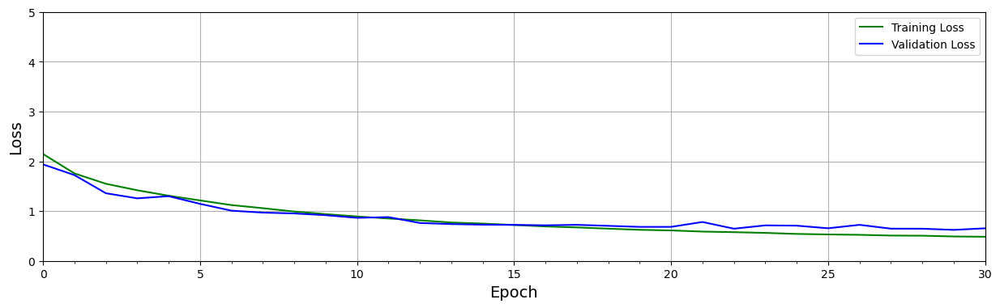

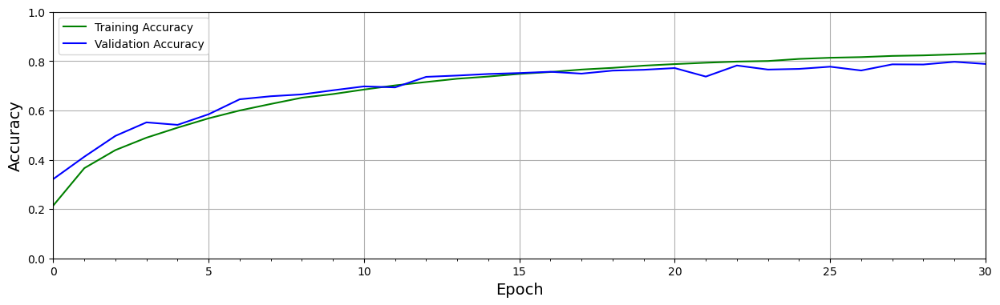

In [57]:
# Plot
# Retrieve training results.
train_loss = history.history["loss"]
train_acc  = history.history["accuracy"]
valid_loss = history.history["val_loss"]
valid_acc  = history.history["val_accuracy"]

plot_results(
    [train_loss, valid_loss],
    ylabel="Loss",
    ylim=[0.0, 5.0],
    metric_name=["Training Loss", "Validation Loss"],
    color=["g", "b"],
)

plot_results(
    [train_acc, valid_acc],
    ylabel="Accuracy",
    ylim=[0.0, 1.0],
    metric_name=["Training Accuracy", "Validation Accuracy"],
    color=["g", "b"],
)

## 6. Saving and Loading Models

In [58]:
# Using the save() method, the model will be saved to the file system in the 'SavedModel' format.
model_dropout.save("model_dropout")

INFO:tensorflow:Assets written to: model_dropout\assets


In [59]:
# Load model
from tensorflow.keras import models
reloaded_model_dropout = models.load_model('model_dropout')

## 7. Model Evaluation

In [60]:
test_loss, test_acc = reloaded_model_dropout.evaluate(X_test, y_test)
print(f"Test accuracy: {test_acc*100:.3f}")

313/313 [==============================] - 1s 3ms/step - loss: 0.6620 - accuracy: 0.7824
Test accuracy: 78.240


In [61]:
def evaluate_model(dataset, model):
    class_names = [
        "airplane",
        "automobile",
        "bird",
        "cat",
        "deer",
        "dog",
        "frog",
        "horse",
        "ship",
        "truck",
    ]
    num_rows = 3
    num_cols = 6

    # Retrieve a number of images from the dataset.
    data_batch = dataset[0 : num_rows * num_cols]

    # Get predictions from model.
    predictions = model.predict(data_batch)

    plt.figure(figsize=(20, 8))
    num_matches = 0

    for idx in range(num_rows * num_cols):
        ax = plt.subplot(num_rows, num_cols, idx + 1)
        plt.axis("off")
        plt.imshow(data_batch[idx])

        pred_idx = tf.argmax(predictions[idx]).numpy()
        truth_idx = np.nonzero(y_test[idx])

        title = str(class_names[truth_idx[0][0]]) + " : " + str(class_names[pred_idx])
        title_obj = plt.title(title, fontdict={"fontsize": 13})

        if pred_idx == truth_idx:
            num_matches += 1
            plt.setp(title_obj, color="g")
        else:
            plt.setp(title_obj, color="r")

        acc = num_matches / (idx + 1)
    print("Prediction accuracy: ", int(100 * acc) / 100)

    return

Prediction accuracy:  0.83


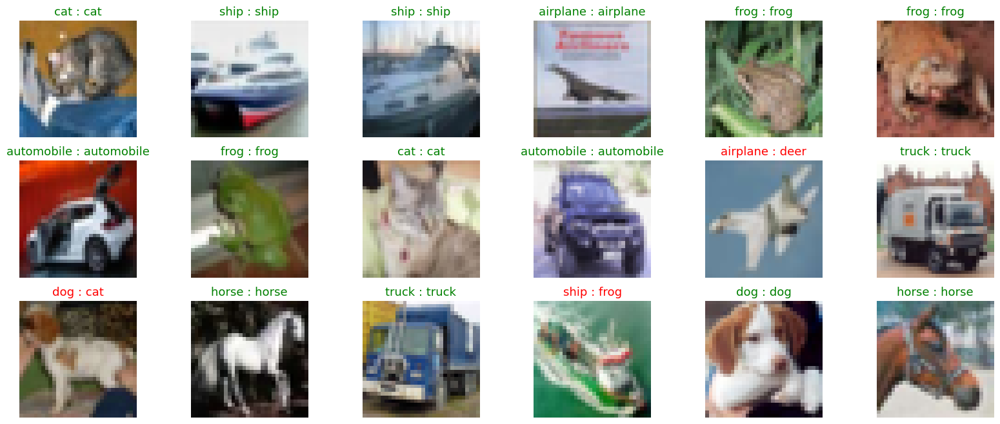

In [62]:
evaluate_model(X_test, reloaded_model_dropout)

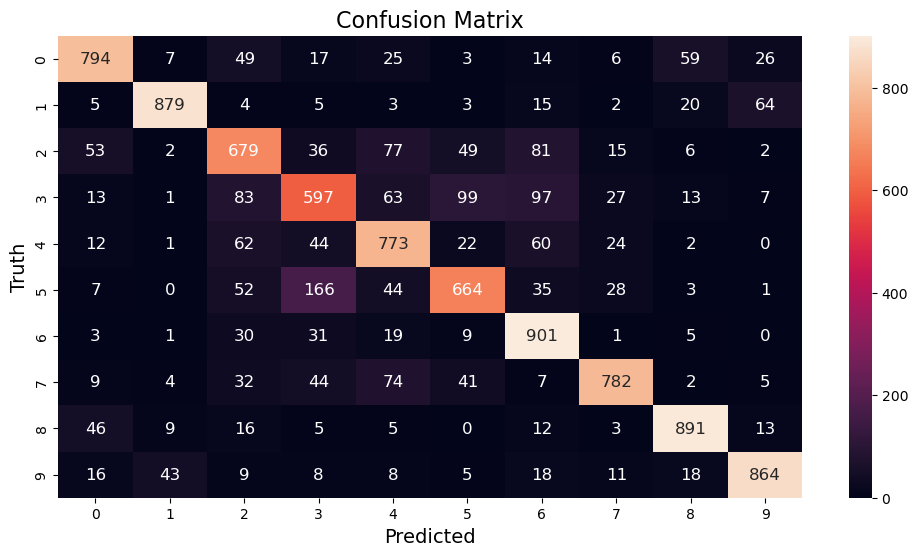

In [63]:
# Generate confusion matrix
# Generate predictions for the test dataset.
predictions = reloaded_model_dropout.predict(X_test)

# For each sample image in the test dataset, select the class label with the highest probability.
predicted_labels = [np.argmax(i) for i in predictions]

# Convert one-hot encoded labels to integers.
y_test_integer_labels = tf.argmax(y_test, axis=1)

# Generate a confusion matrix for the test dataset.
cm = tf.math.confusion_matrix(labels=y_test_integer_labels, predictions=predicted_labels)

# Plot the confusion matrix as a heatmap.
plt.figure(figsize=[12, 6])
import seaborn as sn

sn.heatmap(cm, annot=True, fmt="d", annot_kws={"size": 12})
plt.title("Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("Truth")
plt.show()

## Pre-Trained ImageNet Models in TensorFlow and Keras

### Pre-Trained Models in Keras
The winners of ILSVRC have been very generous in releasing their models to the open-source community. Many models are available in Keras, such as AlexNet, VGGNet, Inception, ResNet, Xception, and many more. Apart from the ILSVRC winners, many research groups also share their models, which they have trained for similar tasks, e.g., MobileNet, SqueezeNet, etc. All the models trained on ImageNet are for classifying images into one of 1,000 classes.

Keras comes bundled with many pre-trained classification models. As of Keras version 2.11, there are 19 different pre-trained models available, where some versions contain many variants as well. The list of models can be found here. Here we will use the following pre-trained models to make predictions on several sample test images.

- VGG16
- ResNet50
- InceptionV3

To use any of the pre-trained models in Keras, there are four basic steps required:

1. Load a pre-trained model
2. Preprocess the input image(s) using a dedicated pre-processing function that is accessible in the model, preprocess_input()
3. Call the model's predict() method to generate predictions
4. De-code the predictions using a dedicated post-processing function that is accessible in the model, decode_predictions()

### 2.1 Instantiate the Model
Here we will use the ResNet50 model to describe the approach. Here we call the built-in model ResNet50() to instantiate the ResNet50 pre-trained model. Notice that the function has several optional arguments, which provide a lot of flexibility for using the model. However, the default settings allow you to use the model right out of the box to perform image classification from 1,000 classes in the ImageNet dataset.

model_resnet50 = tf.keras.applications.resnet50.ResNet50(include_top=True, 
                                                         weights='imagenet', 
                                                         input_tensor=None,
                                                         input_shape=None, 
                                                         pooling=None, 
                                                         classes=1000,
                                                         classifier_activation='softmax',
                                                        )
### 2.2 Preprocess the Inputs
When these models were trained on the ImageNet dataset, the input images were preprocessed in a specific way. Besides resizing images to conform to the expected size of the network, the images are typically zero-centered and normalized. When using these models, it's important that your input images are pre-processed in the same way the training images were processed. For convenience, each model in Keras includes a dedicated pre-processing function preprocess_input. Here x represents a floating point numpy.array or a tf.Tensor containing the image data.

tf.keras.applications.resnet50.preprocess_input(x, data_format=None)
### 2.3 Call the Model's predict() Method
After pre-processing the input images, we can then pass them to the model's predict() method as shown below. Because TensorFlow and Keras process image data in batches, we will need to add a batch dimension to the images, even if we process one image at a time. As an example, ResNet50 expects color images with a shape of [224,224,3], but we must add a batch dimension so that the image batch has a shape: [B, H, W, C], even if we intend to process a single image at a time. We'll see how this is done further below.

preds = model_resnet50.predict(image_batch)
The predictions returned by the predict() method will contain the class probabilities for all 1,000 classes in a NumPy array.

### 2.4 Decode the Predictions
Fortunately, there is a convenience function available for decoding the predictions returned by the model. You can use the model-specific function resnet50.decode_predictions or the imagenet_utils version (both shown below), which will consolidate the top k predictions in descending order.

decoded_preds = tf.keras.applications.resnet50.decode_predictions(
    preds, 
    top=5
)
decoded_preds = tf.keras.applications.imagenet_utils.decode_predictions(
    preds, 
    top=5
)
These functions return a list of the top k (default = 5) predictions, along with the class IDs and class descriptions (names). This makes it easy to parse and report results.

In [16]:
def download_and_unzip(url, save_path):
    print(f"Downloading and extracting assests....", end="")

    # Downloading zip file using urllib package.
    urlretrieve(url, save_path)

    try:
        # Extracting zip file using the zipfile package.
        with ZipFile(save_path) as z:
            # Extract ZIP file contents in the same directory.
            z.extractall(os.path.split(save_path)[0])

        print("Done")

    except Exception as e:
        print("\nInvalid file.", e)

In [6]:
URL = r"https://www.dropbox.com/s/8srx6xdjt9me3do/TF-Keras-Bootcamp-NB07-assets.zip?dl=1"

asset_zip_path = os.path.join(os.getcwd(), "TF-Keras-Bootcamp-NB07-assets.zip")

# Download if assest ZIP does not exists. 
if not os.path.exists(asset_zip_path):
    download_and_unzip(URL, asset_zip_path) 

In [2]:
image_paths = sorted(glob.glob("images" + os.sep + "*.png"))
print(image_paths)

['images\\baseball-player.png', 'images\\clown-fish.png', 'images\\elephant.png', 'images\\forklift.png', 'images\\ice-cream.png', 'images\\lemons.png', 'images\\magnetic-compass.png', 'images\\polar-bear.png']


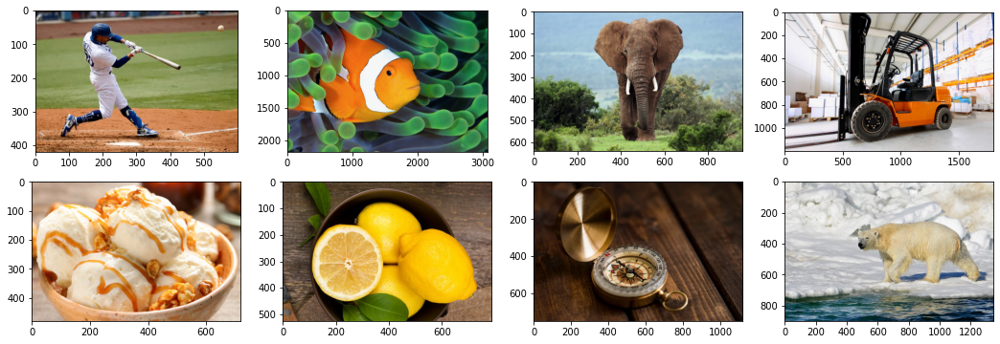

In [3]:
plt.figure(figsize=(18,6))
for idx, image_path in enumerate(image_paths):
    img = plt.imread(image_path)
    plt.subplot(2,4,idx+1)
    plt.imshow(img)
    plt.axis("on")

## Pre-Trained Model Setup

In [4]:
# Load model
model_vgg16 = tf.keras.applications.vgg16.VGG16()
model_vgg19 = tf.keras.applications.vgg19.VGG19()
model_resnet50 = tf.keras.applications.resnet50.ResNet50()
model_inception_v3 = tf.keras.applications.inception_v3.InceptionV3()
model_xception = tf.keras.applications.xception.Xception()

In [5]:
print(model_vgg16.input_shape)
print(model_vgg19.input_shape)
print(model_resnet50.input_shape)
print(model_inception_v3.input_shape)
print(model_xception.input_shape)

(None, 224, 224, 3)
(None, 224, 224, 3)
(None, 224, 224, 3)
(None, 299, 299, 3)
(None, 299, 299, 3)


In [6]:
def process_images(model, image_paths, size, preprocess_input, display_top_k=False, top_k=2):
    
    plt.figure(figsize=(20,7))
    for idx, image_path in enumerate(image_paths):
    
        # Read the image using TensorFlow.
        tf_image = tf.io.read_file(image_path)

        # Decode the above `tf_image` from a Bytes string to a numeric Tensor.
        decoded_image = tf.image.decode_image(tf_image)

        # Resize the image to the spatial size required by the model.
        image_resized = tf.image.resize(decoded_image, size)

        # Add a batch dimension to the first axis (required). 
        image_batch = tf.expand_dims(image_resized, axis=0)

        # Pre-process the input image.
        image_batch = preprocess_input(image_batch)

        # Forward pass through the model to make predictions.
        preds = model.predict(image_batch)

        # Decode (and rank the top-k) predictions. 
        # Returns a list of tuples: (class ID, class description, probability)
        decoded_preds = tf.keras.applications.imagenet_utils.decode_predictions(
            preds=preds,
            top=5
        )
        
        if display_top_k == True:
            for jdx in range(top_k):
                print("Top {} predicted class:   Pr(Class={:20} [index={:4}]) = {:5.2f}".format(
                    jdx + 1, decoded_preds[0][jdx][1], jdx, decoded_preds[0][jdx][2] * 100))
    
        plt.subplot(2,4,idx+1)
        plt.imshow(decoded_image)
        plt.axis('off')
        label = decoded_preds[0][0][1]
        score = decoded_preds[0][0][2] * 100
        title = label + ' ' + str('{:.2f}%'.format(score))
        plt.title(title, fontsize=16)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


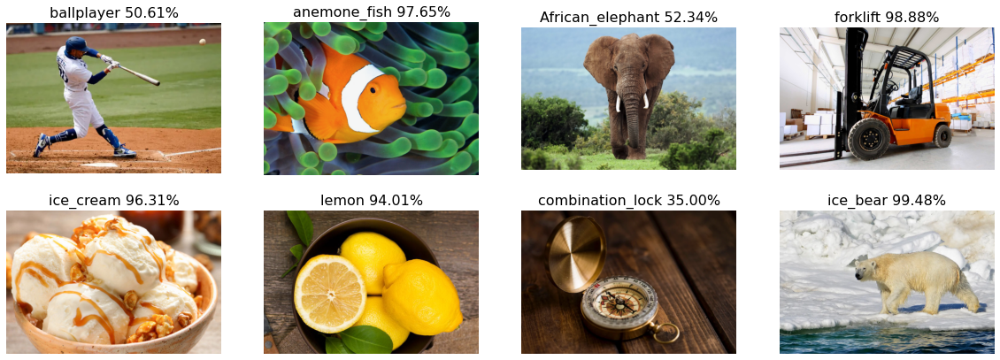

In [7]:
model = model_vgg16
size = (224, 224) 

preprocess_input = tf.keras.applications.vgg16.preprocess_input

process_images(model, image_paths, size, preprocess_input)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


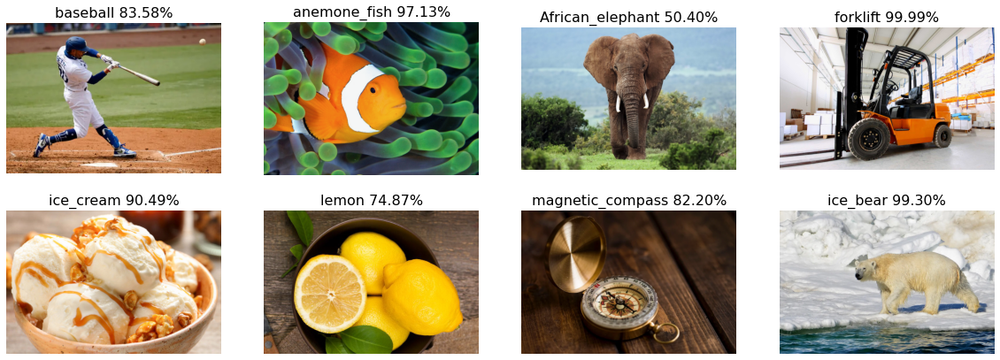

In [8]:
model = model_vgg19
size = (224, 224) 

preprocess_input = tf.keras.applications.vgg19.preprocess_input

process_images(model, image_paths, size, preprocess_input)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


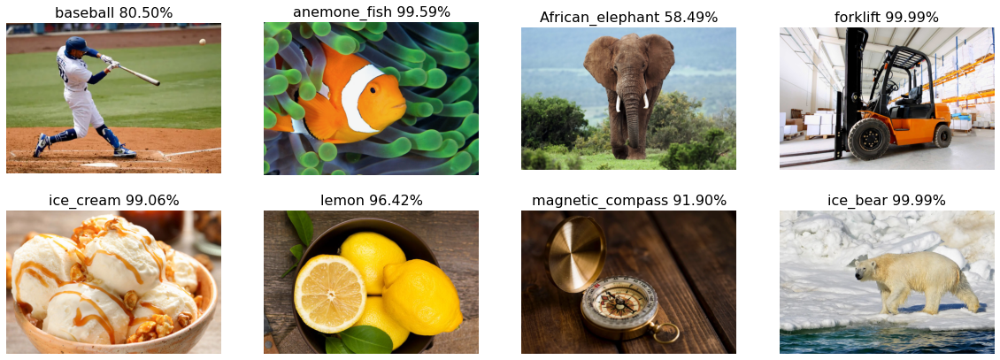

In [9]:
model = model_resnet50
size = (224, 224) 

preprocess_input = tf.keras.applications.resnet50.preprocess_input

process_images(model, image_paths, size, preprocess_input)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Top 1 predicted class:   Pr(Class=ballplayer           [index=   0]) = 69.22
Top 2 predicted class:   Pr(Class=baseball             [index=   1]) = 30.62
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
Top 1 predicted class:   Pr(Class=anemone_fish         [index=   0]) = 92.48
Top 2 predicted class:   Pr(Class=sea_anemone          [index=   1]) =  2.61
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Top 1 predicted class:   Pr(Class=African_elephant     [index=   0]) = 89.94
Top 2 predicted class:   Pr(Class=tusker               [index=   1]) =  7.94
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Top 1 predicted class:   Pr(Class=forklift             [index=   0]) = 98.95
Top 2 predicted class:   Pr(Class=golfcart             [index=   1]) =  0.07
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
Top 1 predicted class:   Pr(Class=ice_cream            [index=   0]) = 99.60
Top 2 predicted class:   Pr(Class=cradle               [index=   1]) =  0.08
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
Top 

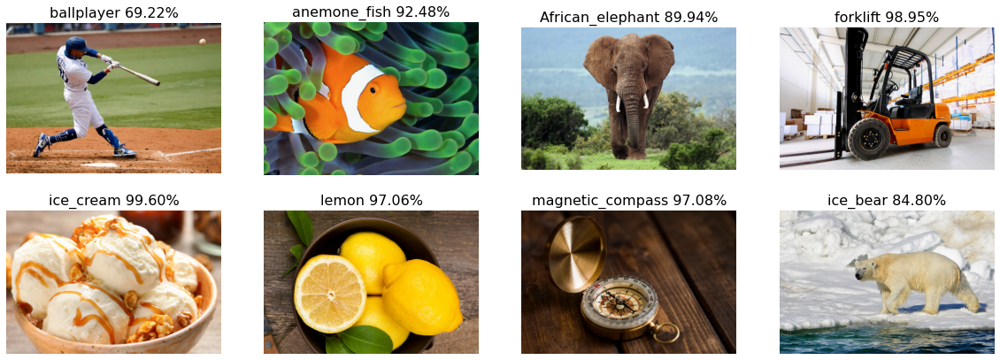

In [11]:
model = model_inception_v3
size = (299, 299)

preprocess_input = tf.keras.applications.inception_v3.preprocess_input

process_images(model, image_paths, size, preprocess_input, display_top_k=True)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 723ms/step
Top 1 predicted class:   Pr(Class=baseball             [index=   0]) = 83.92
Top 2 predicted class:   Pr(Class=ballplayer           [index=   1]) = 13.92
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Top 1 predicted class:   Pr(Class=anemone_fish         [index=   0]) = 87.54
Top 2 predicted class:   Pr(Class=sea_anemone          [index=   1]) =  4.06
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
Top 1 predicted class:   Pr(Class=tusker               [index=   0]) = 48.83
Top 2 predicted class:   Pr(Class=African_elephant     [index=   1]) = 37.52
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
Top 1 predicted class:   Pr(Class=forklift             [index=   0]) = 91.44
Top 2 predicted class:   Pr(Class=turnstile            [index=   1]) =  0.09
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
Top 1 predicted class:   Pr(Class=ice_cream            [index=   0]) = 99.00
Top 2 predicted class:   Pr(Class=trifle               [index=   1]) =  0.30
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
T

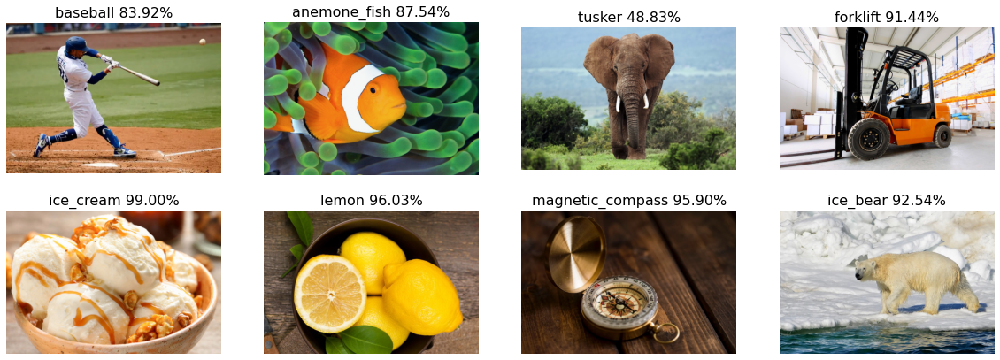

In [12]:
model = model_xception
size = (299, 299)

preprocess_input = tf.keras.applications.xception.preprocess_input

process_images(model, image_paths, size, preprocess_input, display_top_k=True)

## Transfer Learning and Fine-Tuning with Keras and Tensorflow

### Pre-Trained ImageNet Models
If you have a need to perform image classification on a wide range of content that encompasses many of the classes in ImageNet, then using a pre-trained model is an excellent choice. As the name implies, no training is required; you can simply load the model and make predictions on your pre-processed input images. There are many pre-trained models available in Keras, which you can select from. See our previous post on this topic for more details.

For situations where your application contains specific classes that are not contained in ImageNet, you have three additional options. The Keras applications API conveniently provides access to many CNN classification models, which you can load into memory, customize, and train.

![Use case](pretrained_imageNet_model.png)

The sections below summarize the process for each option. It's worth emphasizing that for each training method below, a new classifier needs to be defined for your custom dataset since the pre-trained models in Keras assume an ImageNet classifier with 1,000 outputs. We will cover how to do this in the coding implementation later on in this notebook.

### Transfer Learning
Transfer Learning is a simple approach for re-purposing a pre-trained model to make predictions on a new dataset. The concept is simple. We use the model's pre-trained feature extractor (convolutional base) and re-train a new classifier to learn new weights for the new dataset. This is sometimes referred to as "freezing" the layers in the feature extractor, meaning that we load the pre-trained weights and do not attempt to modify them further during the training process. The theory is that the pre-trained ImageNet Feature Extractor has learned valuable features for detecting many different object types. We assume such features are general enough that we only need to re-train the classifier portion of the network.
![Transfer-learning](tensorflow-keras-transfer-learning-architecture.webp)
This approach requires much less data and computational resources than training from scratch. Remember that training a model often takes many iterations to determine an appropriate set of hyper-parameters for a final model, so the time required to experiment and iterate will be significantly compounded. Since pre-trained models were trained on millions of images, it behooves us to try and leverage that inherent capability. Transfer learning allows you to quickly study how a pre-trained model can be customized for a new dataset. However, sometimes retraining the classifier isn't enough. This is where Fine-Tuning can be very beneficial.

### Fine Tuning
Fine-Tuning represents a flexible alternative to Transfer Learning. It is very similar to Transfer Learning. Instead of locking down the feature extractor completely, we load the feature extractor with ImageNet weights and then freeze the first several layers of the feature extractor but allow the last few layers to be trained further. The idea is that the first several layers in the feature extractor represent generic, low-level features (e.g., edges, corners, and arcs) that are fundamental building blocks necessary to support many classification tasks. Subsequent layers in the feature extractor build upon the lower-level features to learn more complex representations that are more closely related to the content of a particular dataset.
![File-Tuning](tensorflow-keras-fine-tune-architecture-feature-image-NB.png)

With Fine-Tuning, we would like to specifically leverage the lower-level features of the pre-trained model but provide some flexibility for "fine-tuning" the last few layers of the convolutional base to provide the best possible customization for the dataset. So we "freeze" the initial layers (i.e., make them non-trainable) and let the model train the last few layers of the feature extractor, as well as the classifier. Notice that all the layers in the feature extractor are initialized to ImageNet weights. Once training begins, the weights in the last few layers of the feature extractor are updated further, which is why this approach is called Fine-Tuning. Also, notice that the weights in the classifier are initialized to small random values since we want the classifier to learn new weights required to classify new content.

In the remainder of this notebook, we will focus on the Fine-Tuning implementation. We will also spend some time preparing the test dataset, which is in a different format than the training and validation datasets. This presents a good opportunity to explore the methods and techniques that are used to manage image data that are organized differently on the file system.

In [17]:
URL = r"https://www.dropbox.com/s/uzgh5g2bnz40o13/dataset_traffic_signs_40_samples_per_class.zip?dl=1"

dataset_path   = os.path.join(os.getcwd(), "dataset_traffic_signs_40_samples_per_class")
asset_zip_path = os.path.join(os.getcwd(), "dataset_traffic_signs_40_samples_per_class.zip")

# Download if assest ZIP does not exists. 
if not os.path.exists(asset_zip_path):
    download_and_unzip(URL, asset_zip_path)

In [53]:
@dataclass(frozen=True)
class DatasetConfig:
    NUM_CLASSES: int = 43
    IMG_HEIGHT:  int = 224
    IMG_WIDTH:   int = 224
    CHANNELS:    int = 3
        
    DATA_ROOT_TRAIN:  str = os.path.join(dataset_path, "Train")  
    DATA_ROOT_VALID:  str = os.path.join(dataset_path, "Valid")
    DATA_ROOT_TEST:   str = os.path.join(dataset_path, "Test")
    DATA_TEST_GT:     str = os.path.join(dataset_path, "Test.csv")    
        

@dataclass(frozen=True)
class TrainingConfig:
    BATCH_SIZE:       int   = 32
    EPOCHS:           int   = 101
    LEARNING_RATE:    float = 0.0001
    DROPOUT:          float = 0.6
    LAYERS_FINE_TUNE: int   = 8

In [54]:
train_dataset = image_dataset_from_directory(directory=DatasetConfig.DATA_ROOT_TRAIN,
                                             batch_size=TrainingConfig.BATCH_SIZE,
                                             shuffle=True,
                                             seed=SEED_VALUE,
                                             label_mode='int', # Use integer encoding
                                             image_size=(DatasetConfig.IMG_HEIGHT, DatasetConfig.IMG_WIDTH),
                                            )

valid_dataset = image_dataset_from_directory(directory=DatasetConfig.DATA_ROOT_VALID,
                                             batch_size=TrainingConfig.BATCH_SIZE,
                                             shuffle=True,
                                             seed=SEED_VALUE,
                                             label_mode='int', # Use integer encoding
                                             image_size=(DatasetConfig.IMG_HEIGHT, DatasetConfig.IMG_WIDTH),
                                            )

Found 1204 files belonging to 43 classes.
Found 516 files belonging to 43 classes.


In [55]:
# Display the class names from the training dataset.
print(train_dataset.class_names)

['0', '1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '3', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '4', '40', '41', '42', '5', '6', '7', '8', '9']


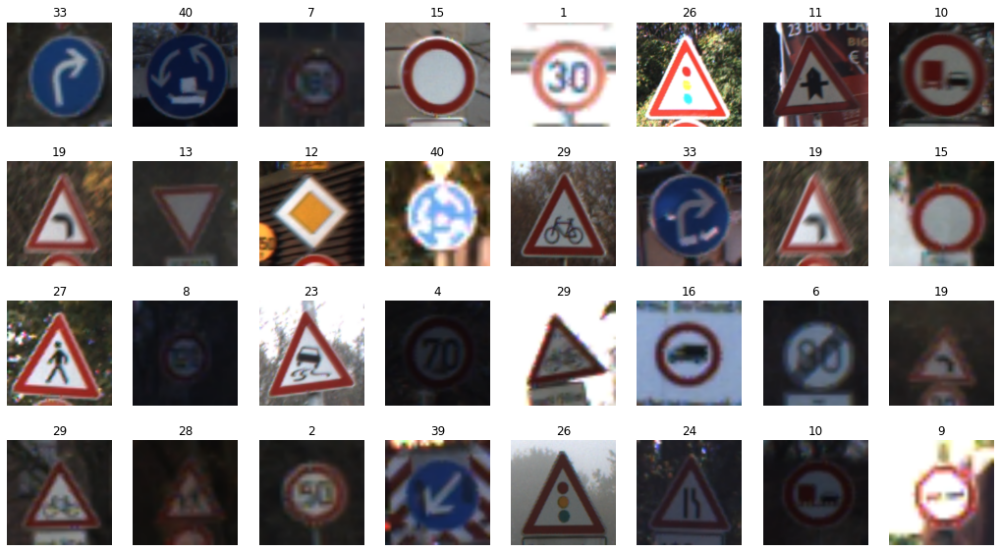

In [56]:
class_names = train_dataset.class_names

plt.figure(figsize=(18, 10))

# Assumes dataset batch_size is at least 32.
num_rows = 4
num_cols = 8

# Here we use the take() method to retrieve just the first batch of data from the training portion of the dataset.
for image_batch, labels_batch in train_dataset.take(1):
    # Plot each of the images in the batch and the associated ground truth labels.
    for i in range(num_rows * num_cols):
        ax = plt.subplot(num_rows, num_cols, i + 1)
        plt.imshow(image_batch[i].numpy().astype("uint8"))
        truth_idx = labels_batch[i].numpy()
        plt.title(class_names[truth_idx])
        plt.axis("off")

In [57]:
import pandas as pd

input_file = DatasetConfig.DATA_TEST_GT

dataset = pd.read_csv(input_file)
df = pd.DataFrame(dataset)
cols = [6]
df = df[df.columns[cols]]
ground_truth_ids = df["ClassId"].values.tolist()
print("Total number of Test labels: ", len(ground_truth_ids))
print(ground_truth_ids[0:10])

Total number of Test labels:  12630
[16, 1, 38, 33, 11, 38, 18, 12, 25, 35]


In [58]:
# For referenece, let's print the class names from the train/valid datasets again.
print(train_dataset.class_names)

['0', '1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '3', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '4', '40', '41', '42', '5', '6', '7', '8', '9']


In [59]:
# Convert train/valid class names to integers.
class_names_int = list(map(int, train_dataset.class_names))

# Create a dictionary mapping ground truth IDs to class name IDs.
gtid_2_cnidx = dict(zip(class_names_int, range(0, DatasetConfig.NUM_CLASSES)))

gtid_2_cnidx.items()

dict_items([(0, 0), (1, 1), (10, 2), (11, 3), (12, 4), (13, 5), (14, 6), (15, 7), (16, 8), (17, 9), (18, 10), (19, 11), (2, 12), (20, 13), (21, 14), (22, 15), (23, 16), (24, 17), (25, 18), (26, 19), (27, 20), (28, 21), (29, 22), (3, 23), (30, 24), (31, 25), (32, 26), (33, 27), (34, 28), (35, 29), (36, 30), (37, 31), (38, 32), (39, 33), (4, 34), (40, 35), (41, 36), (42, 37), (5, 38), (6, 39), (7, 40), (8, 41), (9, 42)])

In [60]:
# Convert the ground truth Class IDs to IDs that correctly map to the same classes
# in the train and validation datasets.
label_ids = []
for idx in range(len(ground_truth_ids)):
    label_ids.append(gtid_2_cnidx[ground_truth_ids[idx]])

print("Original ground truth class IDs: ", ground_truth_ids[0:10])
print("New mapping required:            ", label_ids[0:10])
print("")
print("Train/Valid dataset class names: ", train_dataset.class_names)

Original ground truth class IDs:  [16, 1, 38, 33, 11, 38, 18, 12, 25, 35]
New mapping required:             [8, 1, 32, 27, 3, 32, 10, 4, 18, 29]

Train/Valid dataset class names:  ['0', '1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '3', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '4', '40', '41', '42', '5', '6', '7', '8', '9']


In [61]:
# Get all the path names to the Test images (will prune later)
image_paths = sorted(glob.glob(DatasetConfig.DATA_ROOT_TEST + os.sep + "*.png"))

print(len(image_paths))
print("")
# Print the first 5 image paths to confirm.
for idx in range(5):
    print(image_paths[idx])

12630

D:\Code\myRepo\tensorflow-keras-learning\dataset_traffic_signs_40_samples_per_class\Test\00000.png
D:\Code\myRepo\tensorflow-keras-learning\dataset_traffic_signs_40_samples_per_class\Test\00001.png
D:\Code\myRepo\tensorflow-keras-learning\dataset_traffic_signs_40_samples_per_class\Test\00002.png
D:\Code\myRepo\tensorflow-keras-learning\dataset_traffic_signs_40_samples_per_class\Test\00003.png
D:\Code\myRepo\tensorflow-keras-learning\dataset_traffic_signs_40_samples_per_class\Test\00004.png


In [62]:
test_dataset = tf.data.Dataset.from_tensor_slices((image_paths, label_ids))

In [63]:
def preprocess_image(image):
    # Decode and resize image.
    image = tf.image.decode_png(image, channels=3)
    image = tf.image.resize(image, [DatasetConfig.IMG_HEIGHT, DatasetConfig.IMG_WIDTH])
    return image
def load_and_preprocess_image(path):
    # Read image into memory as a byte string.
    image = tf.io.read_file(path)
    return preprocess_image(image)
def load_and_preprocess_from_path_label(path, label):
    return load_and_preprocess_image(path), label

In [64]:
# Apply the functions above to the test dataset.
test_dataset = test_dataset.map(load_and_preprocess_from_path_label)

# Set the batch size for the dataset.
test_dataset = test_dataset.batch(TrainingConfig.BATCH_SIZE)

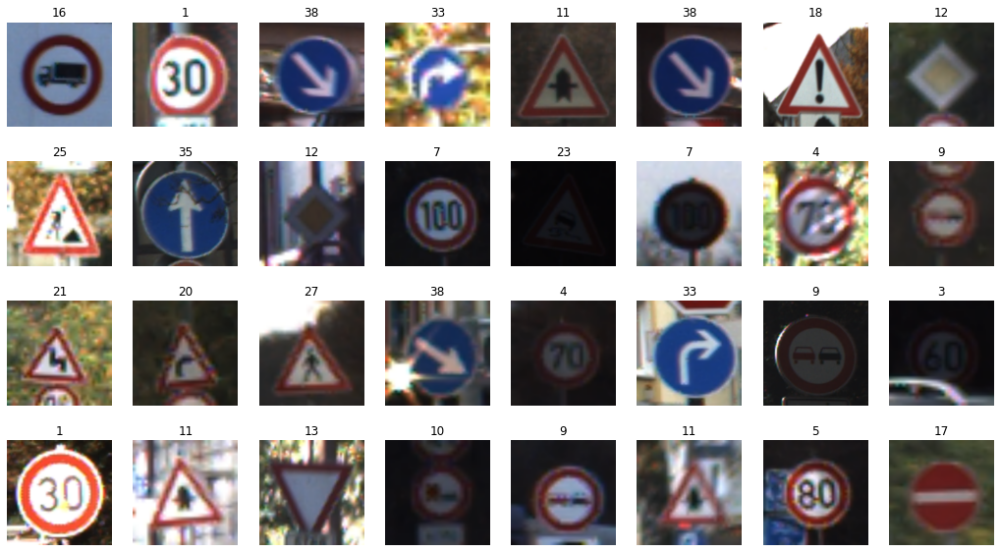

In [65]:
plt.figure(figsize=(18, 10))

# Assumes dataset batch_size is at least 32.
num_rows = 4
num_cols = 8

# Here we use the take() method to retrieve just the first batch of data from the test dataset.
for image_batch, labels_batch in test_dataset.take(1):
    
    # Plot each of the images in the batch and the associated ground truth labels.
    for i in range(num_rows * num_cols):
        ax = plt.subplot(num_rows, num_cols, i + 1)
        plt.imshow(image_batch[i].numpy().astype("uint8"))
        truth_idx = labels_batch[i].numpy()
        plt.title(class_names[truth_idx])
        plt.axis("off")

In [66]:
inception_base = tf.keras.applications.inception_v3.InceptionV3(
    input_shape=input_shape,
    include_top=False,  # Exclude the fully connected layers
    weights='imagenet'  # Use pre-trained ImageNet weights
)
inception_base.summary()

Model: "inception_v3"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_12      │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_286 (Conv2D) │ (None, 111, 111,  │        864 │ input_layer_12[0… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 111, 111,  │         96 │ conv2d_286[0][0]  │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_282      │ (None, 111, 111,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_287 (Conv2D) │ (None, 109, 109,  │      9,216 │ activation_282[0… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │         96 │ conv2d_287[0][0]  │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_283      │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_288 (Conv2D) │ (None, 109, 109,  │     18,432 │ activation_283[0… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │        192 │ conv2d_288[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_284      │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_12    │ (None, 54, 54,    │          0 │ activation_284[0… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_289 (Conv2D) │ (None, 54, 54,    │      5,120 │ max_pooling2d_12… │
│                     │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 54, 54,    │        240 │ conv2d_289[0][0]  │
│ (BatchNormalizatio… │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_285      │ (None, 54, 54,    │          0 │ batch_normalizat… │
│ (Activation)        │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_290 (Conv2D) │ (None, 52, 52,    │    138,240 │ activation_285[0… │
│                     │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 52, 52,    │        576 │ conv2d_290[0][0]  │
│ (BatchNormalizatio… │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_286      │ (None, 52, 52,    │          0 │ batch_normalizat

 Total params: 21,802,784 (83.17 MB)

 Trainable params: 21,768,352 (83.04 MB)

 Non-trainable params: 34,432 (134.50 KB)

In [67]:
inception_base.trainable = True


# Specify the number of layers to fine tune at the end of the convolutional base.
num_layers_fine_tune = TrainingConfig.LAYERS_FINE_TUNE
num_layers = len(inception_base.layers)

# Freeze the initial layers in the base model
for model_layer in inception_base.layers[: num_layers - num_layers_fine_tune]:
    print(f"FREEZING LAYER: {model_layer}")
    model_layer.trainable = False

print("\n")
print(f"Configured to fine-tune the last {num_layers_fine_tune} convolutional layers...")
print("\n")

inception_base.summary()

FREEZING LAYER: <InputLayer name=input_layer_12, built=True>
FREEZING LAYER: <Conv2D name=conv2d_286, built=True>
FREEZING LAYER: <BatchNormalization name=batch_normalization_286, built=True>
FREEZING LAYER: <Activation name=activation_282, built=True>
FREEZING LAYER: <Conv2D name=conv2d_287, built=True>
FREEZING LAYER: <BatchNormalization name=batch_normalization_287, built=True>
FREEZING LAYER: <Activation name=activation_283, built=True>
FREEZING LAYER: <Conv2D name=conv2d_288, built=True>
FREEZING LAYER: <BatchNormalization name=batch_normalization_288, built=True>
FREEZING LAYER: <Activation name=activation_284, built=True>
FREEZING LAYER: <MaxPooling2D name=max_pooling2d_12, built=True>
FREEZING LAYER: <Conv2D name=conv2d_289, built=True>
FREEZING LAYER: <BatchNormalization name=batch_normalization_289, built=True>
FREEZING LAYER: <Activation name=activation_285, built=True>
FREEZING LAYER: <Conv2D name=conv2d_290, built=True>
FREEZING LAYER: <BatchNormalization name=batch_normal

Model: "inception_v3"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_12      │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_286 (Conv2D) │ (None, 111, 111,  │        864 │ input_layer_12[0… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 111, 111,  │         96 │ conv2d_286[0][0]  │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_282      │ (None, 111, 111,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_287 (Conv2D) │ (None, 109, 109,  │      9,216 │ activation_282[0… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │         96 │ conv2d_287[0][0]  │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_283      │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_288 (Conv2D) │ (None, 109, 109,  │     18,432 │ activation_283[0… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │        192 │ conv2d_288[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_284      │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_12    │ (None, 54, 54,    │          0 │ activation_284[0… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_289 (Conv2D) │ (None, 54, 54,    │      5,120 │ max_pooling2d_12… │
│                     │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 54, 54,    │        240 │ conv2d_289[0][0]  │
│ (BatchNormalizatio… │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_285      │ (None, 54, 54,    │          0 │ batch_normalizat… │
│ (Activation)        │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_290 (Conv2D) │ (None, 52, 52,    │    138,240 │ activation_285[0… │
│                     │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 52, 52,    │        576 │ conv2d_290[0][0]  │
│ (BatchNormalizatio… │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_286      │ (None, 52, 52,    │          0 │ batch_normalizat

 Total params: 21,802,784 (83.17 MB)

 Trainable params: 192 (768.00 B)

 Non-trainable params: 21,802,592 (83.17 MB)

In [68]:
from tensorflow import keras
inputs = tf.keras.Input(shape=input_shape)

# Preprocess the inputs for InceptionV3
x = tf.keras.applications.inception_v3.preprocess_input(inputs)

# Pass through the InceptionV3 base model
x = inception_base(x)

# Global Average Pooling
x = layers.GlobalAveragePooling2D()(x)

# Add a dense layer as a classifier
x = layers.Dense(128, activation="relu")(x)
x = layers.Dropout(TrainingConfig.DROPOUT)(x)

# Output layer
outputs = layers.Dense(DatasetConfig.NUM_CLASSES, activation="softmax")(x)

# The final model
model_inception_v3_finetune = tf.keras.Model(inputs, outputs)

model_inception_v3_finetune.summary()


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_13 (InputLayer)     │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ true_divide_2 (TrueDivide)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ subtract_2 (Subtract)           │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ inception_v3 (Functional)       │ (None, 5, 5, 2048)     │    21,802,784 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_1      │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 128)            │       262,272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 43)             │         5,547 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 22,070,603 (84.19 MB)

 Trainable params: 268,011 (1.02 MB)

 Non-trainable params: 21,802,592 (83.17 MB)

In [69]:
# Compile the model
model_inception_v3_finetune.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=TrainingConfig.LEARNING_RATE),
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=["accuracy"],
)

In [70]:
# Train the model
training_results = model_inception_v3_finetune.fit(
    train_dataset,
    epochs=Training,
    validation_data=valid_dataset,
)

Epoch 1/101
38/38 ━━━━━━━━━━━━━━━━━━━━ 34s 782ms/step - accuracy: 0.0349 - loss: 4.0610 - val_accuracy: 0.0562 - val_loss: 3.6857
Epoch 2/101
38/38 ━━━━━━━━━━━━━━━━━━━━ 30s 799ms/step - accuracy: 0.0414 - loss: 3.6576 - val_accuracy: 0.0698 - val_loss: 3.6014
Epoch 3/101
38/38 ━━━━━━━━━━━━━━━━━━━━ 30s 805ms/step - accuracy: 0.0764 - loss: 3.5410 - val_accuracy: 0.0795 - val_loss: 3.5045
Epoch 4/101
38/38 ━━━━━━━━━━━━━━━━━━━━ 32s 847ms/step - accuracy: 0.1144 - loss: 3.4052 - val_accuracy: 0.1221 - val_loss: 3.3780
Epoch 5/101
38/38 ━━━━━━━━━━━━━━━━━━━━ 29s 762ms/step - accuracy: 0.1423 - loss: 3.2644 - val_accuracy: 0.1841 - val_loss: 3.2512
Epoch 6/101
38/38 ━━━━━━━━━━━━━━━━━━━━ 29s 759ms/step - accuracy: 0.1825 - loss: 3.0924 - val_accuracy: 0.2016 - val_loss: 3.1179
Epoch 7/101
38/38 ━━━━━━━━━━━━━━━━━━━━ 29s 759ms/step - accuracy: 0.2264 - loss: 2.9287 - val_accuracy: 0.2539 - val_loss: 3.0001
Epoch 8/101
38/38 ━━━━━━━━━━━━━━━━━━━━ 29s 770ms/step - accuracy: 0.2125 - loss: 2.8981 - 

In [71]:
def plot_results(metrics, ylabel=None, ylim=None, metric_name=None, color=None):
    fig, ax = plt.subplots(figsize=(15, 4))

    if not (isinstance(metric_name, list) or isinstance(metric_name, tuple)):
        metrics = [metrics,]
        metric_name = [metric_name,]

    for idx, metric in enumerate(metrics):
        ax.plot(metric, color=color[idx])

    plt.xlabel("Epoch")
    plt.ylabel(ylabel)
    plt.title(ylabel)
    plt.xlim([0, TrainingConfig.EPOCHS - 1])
    plt.ylim(ylim)
    # Tailor x-axis tick marks
    ax.xaxis.set_major_locator(MultipleLocator(5))
    ax.xaxis.set_major_formatter(FormatStrFormatter("%d"))
    ax.xaxis.set_minor_locator(MultipleLocator(1))
    plt.grid(True)
    plt.legend(metric_name)
    plt.show()
    plt.close()

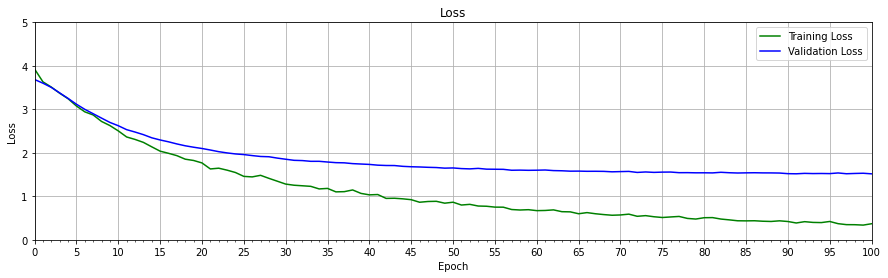

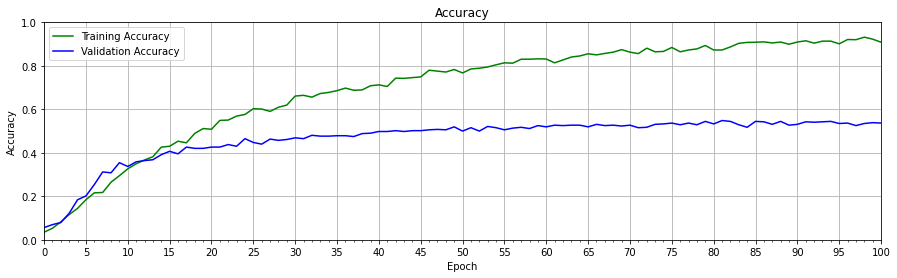

In [72]:
# Retrieve training results.
train_loss = training_results.history["loss"]
train_acc  = training_results.history["accuracy"]
valid_loss = training_results.history["val_loss"]
valid_acc  = training_results.history["val_accuracy"]

plot_results(
    [train_loss, valid_loss],
    ylabel="Loss",
    ylim=[0.0, 5.0],
    metric_name=["Training Loss", "Validation Loss"],
    color=["g", "b"],
)

plot_results(
    [train_acc, valid_acc],
    ylabel="Accuracy",
    ylim=[0.0, 1.0],
    metric_name=["Training Accuracy", "Validation Accuracy"],
    color=["g", "b"],
)

In [73]:
print(f"Model valid accuracy: {model_inception_v3_finetune.evaluate(valid_dataset)[1]*100.:.3f}")

17/17 ━━━━━━━━━━━━━━━━━━━━ 9s 533ms/step - accuracy: 0.5261 - loss: 1.6020
Model valid accuracy: 53.682


In [74]:
print(f"Model test accuracy: {model_inception_v3_finetune.evaluate(test_dataset)[1]*100.:.3f}")

395/395 ━━━━━━━━━━━━━━━━━━━━ 230s 583ms/step - accuracy: 0.6138 - loss: 1.2294
Model test accuracy: 62.130


In [75]:
def display_predictions(dataset, model, class_names):
    
    plt.figure(figsize=(20, 20))
    num_rows = 8
    num_cols = 8
    jdx = 0

    # Evaluate two batches.
    for image_batch, labels_batch in dataset.take(2):
        print(image_batch.shape)

        # Predictions for the current batch.
        predictions = model.predict(image_batch)

        # Loop over all the images in the current batch.
        for idx in range(len(labels_batch)):
            pred_idx = tf.argmax(predictions[idx]).numpy()
            truth_idx = labels_batch[idx].numpy()

            # Set the title color based on the prediction.
            if pred_idx == truth_idx:
                color = "g"
            else:
                color = "r"

            jdx += 1

            if jdx > num_rows * num_cols:
                # Break from the loops if the maximum number of images have been plotted
                break

            ax = plt.subplot(num_rows, num_cols, jdx)
            title = str(class_names[truth_idx]) + " : " + str(class_names[pred_idx])

            title_obj = plt.title(title)
            plt.setp(title_obj, color=color)
            plt.axis("off")
            plt.imshow(image_batch[idx].numpy().astype("uint8"))
    return

(32, 224, 224, 3)
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
(32, 224, 224, 3)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 521ms/step


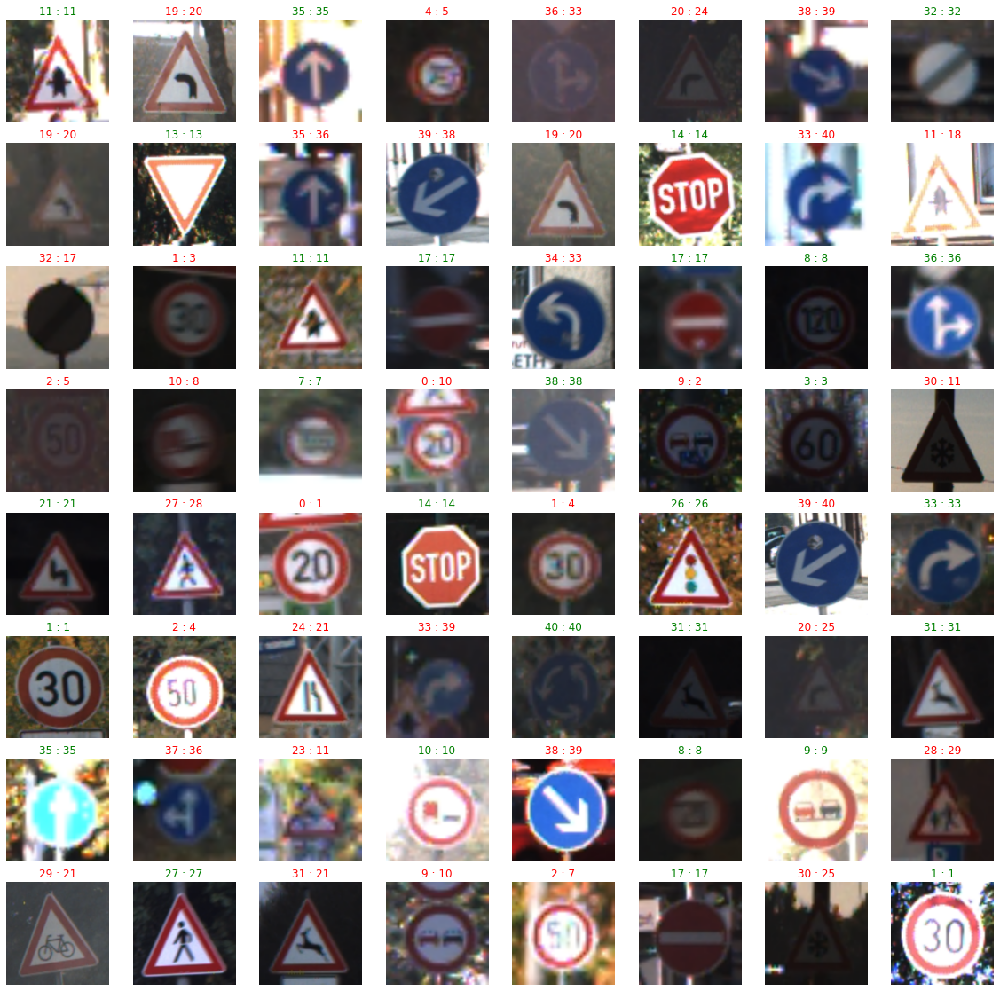

In [76]:
display_predictions(valid_dataset, model_inception_v3_finetune, class_names)

(32, 224, 224, 3)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 512ms/step
(32, 224, 224, 3)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 519ms/step


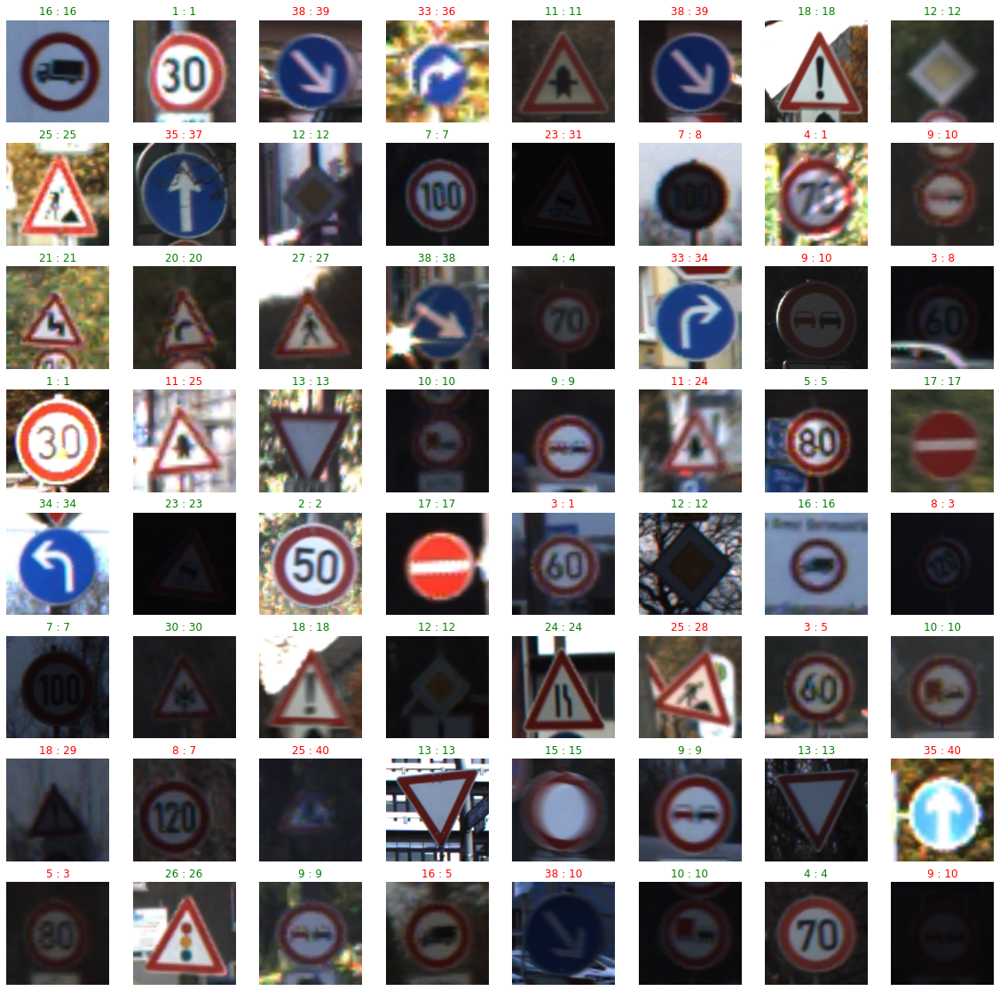

In [77]:
display_predictions(test_dataset, model_inception_v3_finetune, class_names)

In [4]:
def download_and_unzip(url, save_path):
    print(f"Downloading and extracting assests....", end="")

    # Downloading zip file using urllib package.
    urlretrieve(url, save_path)

    try:
        # Extracting zip file using the zipfile package.
        with ZipFile(save_path) as z:
            # Extract ZIP file contents in the same directory.
            z.extractall(os.path.split(save_path)[0])

        print("Done")

    except Exception as e:
        print("\nInvalid file.", e)

In [5]:
URL = r"https://www.dropbox.com/s/wad5js22fbeo1be/camvid_images.zip?dl=1"

asset_zip_path = os.path.join(os.getcwd(), "camvid_images.zip")

# Download if assest ZIP does not exists.
if not os.path.exists(asset_zip_path):
    download_and_unzip(URL, asset_zip_path)

In [6]:
def load_image(path):
    image = cv2.imread(path)

    # Convert image in BGR format to RGB.
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Add a batch dimension which is required by the model.
    image = np.expand_dims(image, axis=0) / 255.0

    return image

camvid_images\camvid_sample_1.png
camvid_images\camvid_sample_2.png
camvid_images\camvid_sample_3.png
camvid_images\camvid_sample_4.png


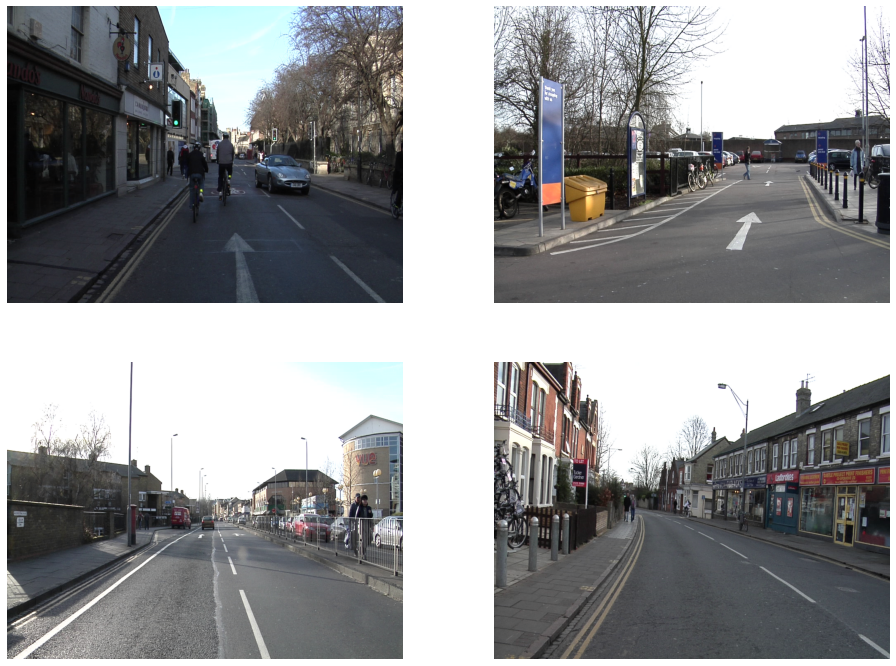

In [11]:
image_paths = sorted(glob.glob("camvid_images" + os.sep + "*.png"))

for idx in range(len(image_paths)):
    print(image_paths[idx])
images = []
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(16, 12))

for idx, axis in enumerate(ax.flat):
    image = load_image(image_paths[idx])
    images.append(image)
    axis.imshow(image[0])
    axis.axis("off")

### 1.1 Define a Dictionary that Maps Class IDs to Class Names and Class Colors

`class_index` is a dictionary that maps all 32 classes in the CamVid dataset with their associated class IDs and RGB color labels.

In [12]:
class_index = \
    {
         0: [(64, 128, 64),  'Animal'],
         1: [(192, 0, 128),  'Archway'],
         2: [(0, 128, 192),  'Bicyclist'],
         3: [(0, 128, 64),   'Bridge'],
         4: [(128, 0, 0),    'Building'],
         5: [(64, 0, 128),   'Car'],
         6: [(64, 0, 192),   'Cart/Luggage/Pram'],
         7: [(192, 128, 64), 'Child'],
         8: [(192, 192, 128),'Column Pole'],
         9: [(64, 64, 128),  'Fence'],
        10: [(128, 0, 192),  'LaneMkgs Driv'],
        11: [(192, 0, 64),   'LaneMkgs NonDriv'],
        12: [(128, 128, 64), 'Misc Text'],
        13: [(192, 0, 192),  'Motorcycle/Scooter'],
        14: [(128, 64, 64),  'Other Moving'],
        15: [(64, 192, 128), 'Parking Block'],
        16: [(64, 64, 0),    'Pedestrian'],
        17: [(128, 64, 128), 'Road'],
        18: [(128, 128, 192),'Road Shoulder'],
        19: [(0, 0, 192),    'Sidewalk'],
        20: [(192, 128, 128),'Sign Symbol'],
        21: [(128, 128, 128),'Sky'],
        22: [(64, 128, 192), 'SUV/Pickup/Truck'],
        23: [(0, 0, 64),     'Traffic Cone'],
        24: [(0, 64, 64),    'Traffic Light'],
        25: [(192, 64, 128), 'Train'],
        26: [(128, 128, 0),  'Tree'],
        27: [(192, 128, 192),'Truck/Bus'],
        28: [(64, 0, 64),    'Tunnel'],
        29: [(192, 192, 0),  'Vegetation Misc'],
        30: [(0, 0, 0),      'Void'],
        31: [(64, 192, 0),   'Wall']  
    }

## 2 Model Inference using TensorFlow Hub

TensorFlow Hub contains many different pre-trained segmentation models. Here we will use the High-Resolution Network (HRNet) segmentation model trained on CamVid (camvid-hrnetv2-w48). The model has been pre-trained on the Imagenet ILSVRC-2012 classification task and fine-tuned on CamVid.

### 2.1 Load the Model from TensorFlow Hub
We can load the model into memory using the url to the model page.

In [13]:
model_url = "https://tfhub.dev/google/HRNet/camvid-hrnetv2-w48/1"
print("loading model:", model_url)

seg_model = hub.load(model_url)
print("\nmodel loaded!")

loading model: https://tfhub.dev/google/HRNet/camvid-hrnetv2-w48/1




model loaded!


### 2.2 Perform Inference
Before we formalize the code to process several images and post-process the results, let's first see how to perform inference on a single image and study the output from the model.

#### 2.2.1 Call the Model's precict() Method

In [14]:
# Make a prediction using the first image in the list of images.
pred_mask = seg_model.predict(images[0])

# The predicted mask has the following shape: [B, H, W, C].
print("Shape of predicted mask:", pred_mask.shape)

Shape of predicted mask: (1, 720, 960, 33)


#### 2.2.2 Post-Process the Predicted Segmentation Mask
The predicted segmentation mask returned by the model contains a separate channel for each class. Each channel contains the probability that a given pixel from the input image is associated with the class for that channel. This data, therefore, requires some post-processing to obtain meaningful results. Several steps need to be performed to arrive at a final visual representation.

1. Remove the batch dimension and the background class.
2. Assign a class label to every pixel in the image based on the highest probability score across all channels.
3. The previous step results in a single-channel image that contains the class labels for each pixel. We, therefore, need to map those class IDs to RGB values so we can visualize the results as a color-coded segmentation map

Remove Batch Dimension and Background Class

In [15]:
# Convert mask to numpy array
pred_mask = pred_mask.numpy()
# The 1st label is the background class added by the model, but we can remove it for this dataset.
pred_mask = pred_mask[:, :, :, 1:] # Remove the first class (background)
# We also need to remove the batch dimension
pred_mask = np.squeeze(pred_mask)

# Print the shape to confirm [H,W,C]
print(pred_mask.shape)


(720, 960, 32)


Visualize the Intermediate results

(-0.5, 959.5, 719.5, -0.5)

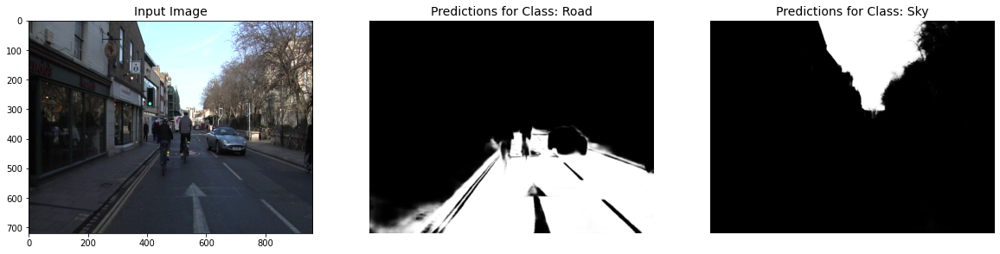

In [21]:
plt.figure(figsize=(20,6))

plt.subplot(1,3,1)
plt.title("Input Image", fontsize=14)
plt.imshow(np.squeeze(images[0]))

plt.subplot(1,3,2)
plt.title("Predictions for Class: Road", fontsize=14)
plt.imshow(pred_mask[:, :, 17], cmap='gray') # Class 17 correspond to Road
plt.axis('off')

plt.subplot(1,3,3)
plt.title("Predictions for Class: Sky", fontsize=14)
plt.imshow(pred_mask[:, :, 21], cmap='gray') # Class 21 correspond to Sky
plt.axis('off')

<span style="color: blue">Assign Each Pixel a Class Label</span>

Here we assign every pixel in the image with a class ID based on the class with the highest probability. We can visualize this as a grayscale image. In the code cell below, we will display just the top portion of the image to highlight a few of the class asignments.

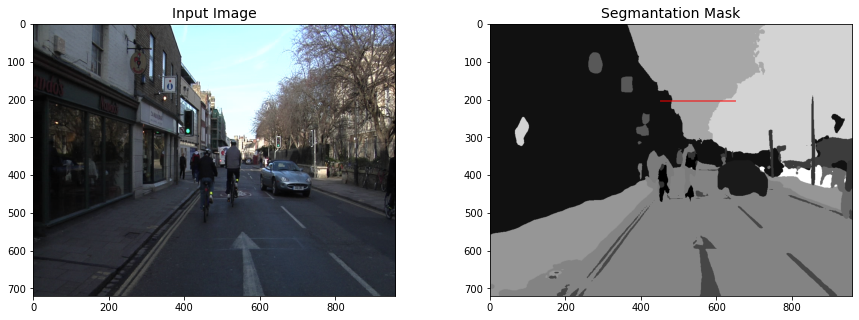

In [22]:
# Assign each pixel in the image a class ID based on the channel that contains the
# highest probability score, this can be implemented using argmax function
pred_mask_class = np.argmax(pred_mask, axis=-1)

plt.figure(figsize=(15,5))

plt.subplot(1,2,1)
plt.title("Input Image", fontsize=14)
plt.imshow(np.squeeze(images[0]))

plt.subplot(1,2,2)
plt.title("Segmantation Mask", fontsize=14)
plt.imshow(pred_mask_class, cmap='gray')
plt.gca().add_patch(Rectangle((450, 200), 200, 3, edgecolor='red', facecolor='none', lw=.5))

Let's now inspect a small region of the segmentation mask to better understand how the values map to class IDs. For reference, the top portion (200 rows) of the segmentation mask (`pred_mask_class`) have been overlayed on the input image. Notice that regions in the segmentation mask correspond to distinct regions in the input image (e.g., buildings, sky, trees).

In [23]:
# Print the class IDs from the last row in the above image.
print(pred_mask_class[200, 450:650])

[ 4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4
  4  4  4  4  4  4  4  4 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21
 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21
 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21
 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21
 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21
 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21
 26 26 21 21 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26
 26 26 26 26 26 26 26 26]


##### Convert the Single Channel Mask to a Color Representation
We will also need to make use of the function below that will convert a single channel mask to an RGB representation for visualization purposes. Each class ID in the single-channel mask will be converted to a different color according to the class_index dictionary mapping.

In [25]:
# Function to convert a single channel mask representation to an RGB mask
def class_to_rgb(mask_class, class_index):

    # Create RGB channel
    r_map = np.zeros_like(mask_class).astype(np.uint8)
    g_map = np.zeros_like(mask_class).astype(np.uint8)
    b_map = np.zeros_like(mask_class).astype(np.uint8)

    # Populate RGB color channels based on the color assigned to each class
    for class_id in range(len(class_index)):
        index = mask_class == class_id
        r_map[index] = class_index[class_id][0][0]
        g_map[index] = class_index[class_id][0][1]
        b_map[index] = class_index[class_id][0][2]

    seg_map_rgb = np.stack([r_map, g_map, b_map], axis=2)
    return seg_map_rgb

(-0.5, 959.5, 719.5, -0.5)

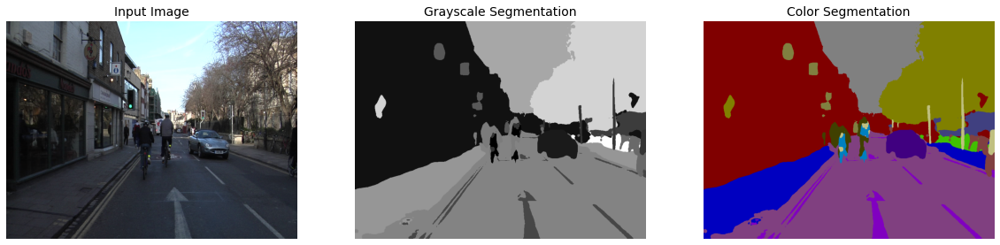

In [26]:
pred_map_rgb = class_to_rgb(pred_mask_class, class_index)

plt.figure(figsize=(20,8))

plt.subplot(1,3,1)
plt.title("Input Image", fontsize=14)
plt.imshow(np.squeeze(images[0]))
plt.axis('off')

plt.subplot(1,3,2)
plt.title("Grayscale Segmentation", fontsize=14)
plt.imshow(pred_mask_class, cmap='gray')
plt.axis('off')

plt.subplot(1,3,3)
plt.title("Color Segmentation", fontsize=14)
plt.imshow(pred_map_rgb, cmap='gray')
plt.axis('off')


## 3 Formalize the Implementation
In this section, we will formalize the implementation and will need to define some additional convenience functions.

### 3.1 `image_overlay()`
`image_overlay()` is a helper function to overlay an RGB mask on top of the original image to better appreciate how the predictions line up with the original image.

In [32]:
# Function to overlay a segmentation map on top ò RGB image
def image_overlay(image, seg_map_rgb):
    alpha = 1.0 # Transparency of original map
    beta = 0.6  # Transparency of segmentation map
    gamma = 0.0 # Scalar added to sum

    image = (image*255.0).astype(np.uint8)
    seg_map_rgb = cv2.cvtColor(seg_map_rgb, cv2.COLOR_RGB2BGR)

    image = cv2.addWeighted(image, alpha, seg_map_rgb, beta, gamma)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    return image

### 3.2 `run_inference()`
To perform inference on several images, we define the function below, which accepts a list of images and a pre-trained model. This function also handles all of the post-processing required to compute the final segmentation mask as well as the overlay.

In [28]:
def run_interface(images, model):
    for img in images:

        # Forward pass through the model (convert the tensor output to a np array)
        pred_mask = model.predict(img).numpy()

        # Remove the background class added by the model
        pred_mask = pred_mask[:,:,:,1:]

        # Remove the batch dimension
        pred_mask = np.squeeze(pred_mask)

        # pred_mask is a np array of shape [H,W,32] where each channel contains the probability
        # scores associated with a given class. We still need to assign each single class to each
        # pixel which is accomplished using argmax across the last dimensions to obtain the class labels
        pred_mask_class = np.argmax(pred_mask, axis=-1)

        # Convert the predicted (class) segmentation map to color segmentation map
        pred_mask_rgb = class_to_rgb(pred_mask_class, class_index)

        # Display
        fig = plt.figure(figsize=(20, 15))

        # Display the original image.
        ax1 = fig.add_subplot(1, 3, 1)
        ax1.imshow(img[0])
        ax1.title.set_text("Input Image")
        plt.axis("off")

        # Display the predicted color segmentation mask.
        ax2 = fig.add_subplot(1, 3, 2)
        ax2.set_title("Predicted Mask")
        ax2.imshow(pred_mask_rgb)
        plt.axis("off")

        # Display the predicted color segmentation mask overlayed on the original image.
        overlayed_image = image_overlay(img[0], pred_mask_rgb)
        ax4 = fig.add_subplot(1, 3, 3)
        ax4.set_title("Overlayed Image")
        ax4.imshow(overlayed_image)
        plt.axis("off")

        plt.show()

### 3.3 `plot_color_legend()`
The function plot_color_legend() creates a color legend for the CamVid dataset, which is helpful for confirming the class assignments by the model.

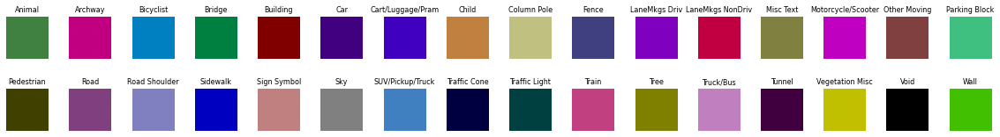

In [29]:
def plot_color_legend(class_index):
    # Extract colors and labels from class_index dictionary.
    color_array = np.array([[v[0][0], v[0][1], v[0][2]] for v in class_index.values()]).astype(np.uint8)
    class_labels = [val[1] for val in class_index.values()]

    fig, ax = plt.subplots(nrows=2, ncols=16, figsize=(20, 3))
    plt.subplots_adjust(wspace=0.5, hspace=0.01)

    # Display color legend.
    for i, axis in enumerate(ax.flat):
        axis.imshow(color_array[i][None, None, :])
        axis.set_title(class_labels[i], fontsize=8)
        axis.axis("off")

plot_color_legend(class_index)

### 3.4 Make Predictions on the Sample Images
Now, let's use this function to perform inference on the sample images using the three models we selected above.

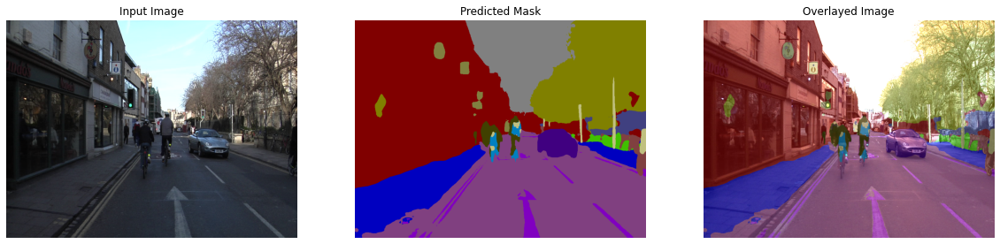

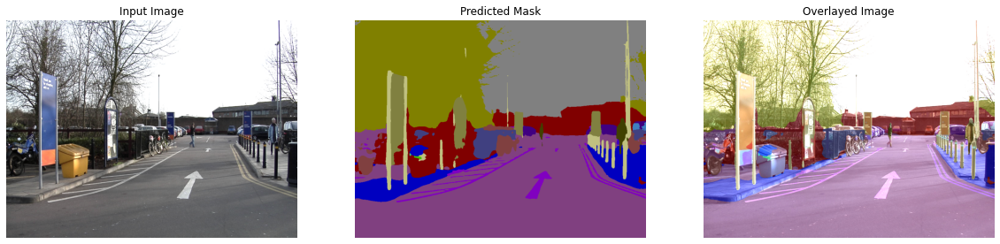

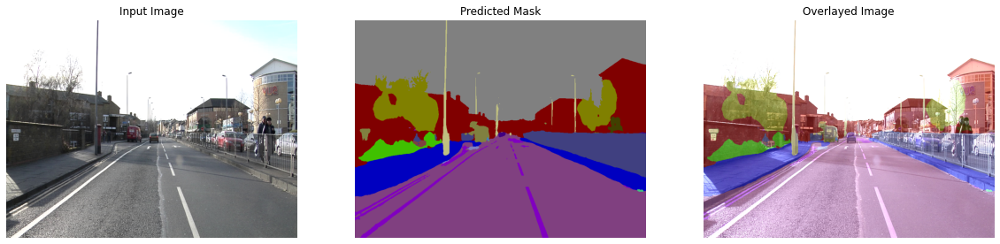

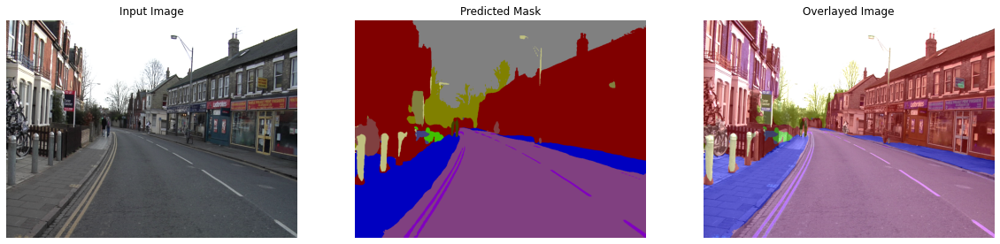

In [33]:
run_interface(images, seg_model)

# Object Detection using Tensorflow Hub

In [37]:
def download_file(url, save_name):
    url = url
    file = requests.get(url)

    open(save_name, 'wb').write(file.content)
def unzip(zip_file=None):
    try:
        with zipfile.ZipFile(zip_file) as z:
            z.extractall("./")
            print("Extracted all")
    except:
        print("Invalid file")
download_file( 
    'https://www.dropbox.com/s/h7l1lmhvga6miyo/object_detection_images.zip?dl=1',
    'object_detection_images.zip'
)
    
unzip(zip_file='object_detection_images.zip')

Extracted all


object_detection_images\dog_bicycle_car.png
object_detection_images\elephants.png
object_detection_images\home_interior.png
object_detection_images\place_setting.png


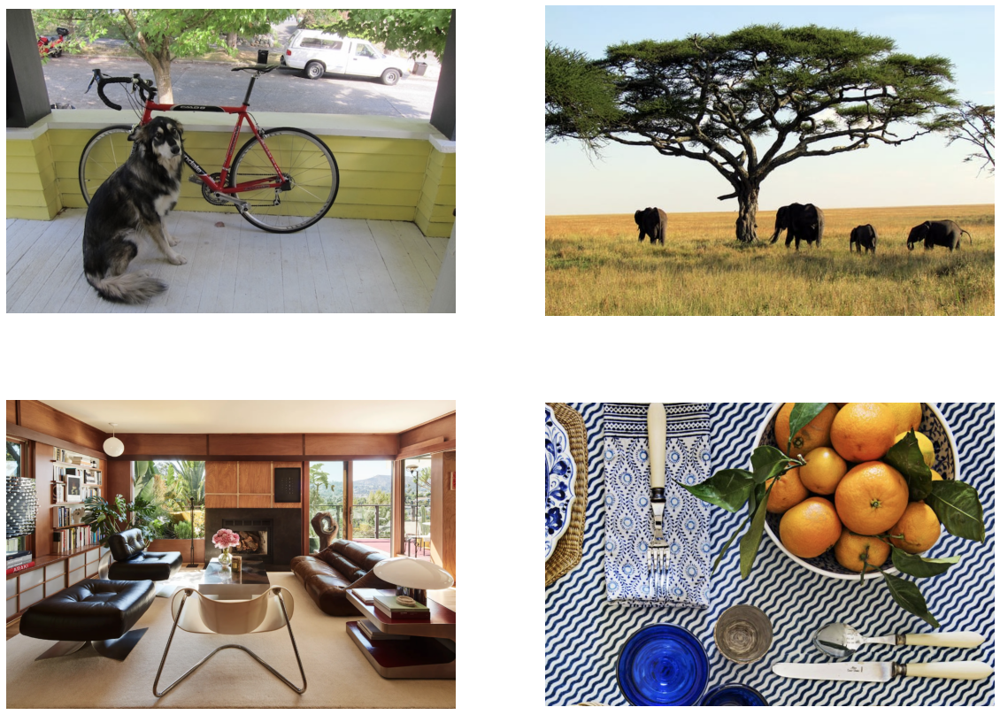

In [38]:
image_paths = sorted(glob.glob('object_detection_images' + '/*.png'))

for idx in range(len(image_paths)):
    print(image_paths[idx])

def load_image(path):

    image = cv2.imread(path)
    
    # Convert image in BGR format to RGB.
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # Add a batch dimension which is required by the model.
    image = np.expand_dims(image, axis=0)
    
    return image

images = []
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(20, 15))

idx=0
for axis in ax.flat:
    image = load_image(image_paths[idx])
    images.append(image)
    axis.imshow(image[0])
    axis.axis('off')
    idx+=1

In [39]:
class_index =  \
{
         1: 'person',
         2: 'bicycle',
         3: 'car',
         4: 'motorcycle',
         5: 'airplane',
         6: 'bus',
         7: 'train',
         8: 'truck',
         9: 'boat',
         10: 'traffic light',
         11: 'fire hydrant',
         13: 'stop sign',
         14: 'parking meter',
         15: 'bench',
         16: 'bird',
         17: 'cat',
         18: 'dog',
         19: 'horse',
         20: 'sheep',
         21: 'cow',
         22: 'elephant',
         23: 'bear',
         24: 'zebra',
         25: 'giraffe',
         27: 'backpack',
         28: 'umbrella',
         31: 'handbag',
         32: 'tie',
         33: 'suitcase',
         34: 'frisbee',
         35: 'skis',
         36: 'snowboard',
         37: 'sports ball',
         38: 'kite',
         39: 'baseball bat',
         40: 'baseball glove',
         41: 'skateboard',
         42: 'surfboard',
         43: 'tennis racket',
         44: 'bottle',
         46: 'wine glass',
         47: 'cup',
         48: 'fork',
         49: 'knife',
         50: 'spoon',
         51: 'bowl',
         52: 'banana',
         53: 'apple',
         54: 'sandwich',
         55: 'orange',
         56: 'broccoli',
         57: 'carrot',
         58: 'hot dog',
         59: 'pizza',
         60: 'donut',
         61: 'cake',
         62: 'chair',
         63: 'couch',
         64: 'potted plant',
         65: 'bed',
         67: 'dining table',
         70: 'toilet',
         72: 'tv',
         73: 'laptop',
         74: 'mouse',
         75: 'remote',
         76: 'keyboard',
         77: 'cell phone',
         78: 'microwave',
         79: 'oven',
         80: 'toaster',
         81: 'sink',
         82: 'refrigerator',
         84: 'book',
         85: 'clock',
         86: 'vase',
         87: 'scissors',
         88: 'teddy bear',
         89: 'hair drier',
         90: 'toothbrush'
}

Here we will use `COLOR_IDS` to map each class with a unique RGB color

In [40]:
R = np.array(np.arange(96,256,32))
G = np.roll(R, 1)
B = np.roll(R, 2)

COLOR_IDS = np.array(np.meshgrid(R,G,B)).T.reshape(-1,3)

## 2 Model Inference using Tensorflow Hub
TensorFlow Hub contains many different pre-trained object detection models. Here we will use the EfficientDet class of object detection models that were trained on the COCO 2017 dataset. There are several versions of EfficientDet models. The EfficientDet family of object detectors consists of several models with different levels of complexity and performance, ranging from D0 to D7. The differences between the various models in the EfficientDet family are mainly in their architecture, input image size, computational requirements, and performance.

In [41]:
EfficientDet  = {'EfficientDet D0 512x512'   : 'https://tfhub.dev/tensorflow/efficientdet/d0/1',
                 'EfficientDet D1 640x640'   : 'https://tfhub.dev/tensorflow/efficientdet/d1/1',
                 'EfficientDet D2 768x768'   : 'https://tfhub.dev/tensorflow/efficientdet/d2/1',
                 'EfficientDet D3 896x896'   : 'https://tfhub.dev/tensorflow/efficientdet/d3/1',
                 'EfficientDet D4 1024x1024' : 'https://tfhub.dev/tensorflow/efficientdet/d4/1',
                 'EfficientDet D5 1280x1280' : 'https://tfhub.dev/tensorflow/efficientdet/d5/1',
                 'EfficientDet D6 1280x1280' : 'https://tfhub.dev/tensorflow/efficientdet/d6/1',
                 'EfficientDet D7 1536x1536' : 'https://tfhub.dev/tensorflow/efficientdet/d7/1'
                }

In [42]:
model_url = EfficientDet['EfficientDet D4 1024x1024' ]

print('loading model: ', model_url)
od_model = hub.load(model_url)

print('\nmodel loaded!')

loading model:  https://tfhub.dev/tensorflow/efficientdet/d4/1

model loaded!


### 2.2 Perform Inference
Before we formalize the code to process several images and post-process the results, let's first see how to perform inference on a single image and study the output from the model.
#### 2.2.1 Call the Model

In [43]:
# Call the model. # The model returns the detection results in the form of a dictionary.
results = od_model(images[0])

#### 2.2.2 Inspect the Results
The object detection model returns the detection results in the form of a dictionary which includes several different types of keys.

In [44]:
# Convert the dictionary values to numpy arrays.
results = {key:value.numpy() for key, value in results.items()}

In [45]:
# Print the keys from the results dictionary.
for key in results:
    print(key) 

raw_detection_boxes
detection_multiclass_scores
detection_classes
detection_boxes
raw_detection_scores
num_detections
detection_anchor_indices
detection_scores


Notice that the model has several dictionary keys that can be used to access various types of detection data. EfficientDet, like many other object detection models, generates a large number of raw detections (bounding boxes and corresponding class scores) for each input image. Many of these raw detections are redundant, overlapping, or have low confidence scores. To obtain meaningful results, post-processing techniques are applied within the model to filter and refine these raw detections. For our purposes, we are only interested in the detections that have been post-processed within the model, which are available in the dictionary keys that start with detection_.

In the following code cells, we show that there are thousands of raw detections, while there are 16 final detections. Each of these final detections has an associated confidence score which we may want to filter further depending on the nature of our application.

In [46]:
print('Num Raw Detections: ', (len(results['raw_detection_scores'][0])))
print('Num Detections:     ', (results['num_detections'][0]).astype(int))

Num Raw Detections:  196416
Num Detections:      100


In [47]:
# Print the Scores, Classes and Bounding Boxes for the detections.
num_dets = (results['num_detections'][0]).astype(int)

print('\nDetection Scores: \n\n', results['detection_scores'][0][0:num_dets])
print('\nDetection Classes: \n\n', results['detection_classes'][0][0:num_dets])
print('\nDetection Boxes: \n\n', results['detection_boxes'][0][0:num_dets])


Detection Scores: 

 [0.90533066 0.87894064 0.7202936  0.35475993 0.28056255 0.17850243
 0.15169758 0.14906055 0.14454065 0.13583478 0.12682495 0.11745183
 0.10780194 0.10151783 0.10052411 0.09747413 0.09338368 0.0932879
 0.09095502 0.08784286 0.08294908 0.08292697 0.08103952 0.07869296
 0.07779158 0.07524478 0.07296468 0.07162406 0.07000013 0.06879055
 0.06795245 0.06612458 0.06535593 0.06445775 0.06108105 0.0595669
 0.05944292 0.05919532 0.05845254 0.0582372  0.05798645 0.05783073
 0.05775054 0.05753617 0.05747186 0.05707671 0.05703342 0.05582747
 0.05510024 0.05509661 0.05461619 0.05444638 0.05370706 0.05335523
 0.05323364 0.05098716 0.05098482 0.04960293 0.04953305 0.04781677
 0.04760983 0.0472828  0.04687167 0.04676606 0.0462728  0.04581975
 0.04572141 0.04525172 0.04518342 0.04492665 0.04447951 0.043266
 0.04299228 0.04221687 0.04141534 0.04104364 0.04087302 0.040613
 0.04059266 0.04027567 0.04010023 0.0392597  0.03919701 0.03858818
 0.03826005 0.03815683 0.03804019 0.03789712 0

#### 2.2.3 Post-Process and Display Detections
Here we show the logic for how to interpret the detection data for a single image. As we showed above, the model returned 16 detections, however, many detections have low confidence scores and we, therefore, need to filter these further by using a minimum detection threshold.

1. Retrieve the detections from the results dictionary
2. Apply a minimum detection threshold to filter the detections
3. For each thresholded detection, display the bounding box and a label indicating the detected class and the confidence of the detection.

In [48]:
def process_detection(image, results,  min_det_thresh=.3):

    # Extract the detection results from the results dictionary.
    scores  =  results['detection_scores'][0]
    boxes   =  results['detection_boxes'][0]
    classes = (results['detection_classes'][0]).astype(int)

    # Set a minimum detection threshold to post-process the detection results.
    min_det_thresh = min_det_thresh

    # Get the detections whose scores exceed the minimum detection threshold.
    det_indices = np.where(scores >= min_det_thresh)[0]

    scores_thresh  = scores[det_indices]
    boxes_thresh   = boxes[det_indices]
    classes_thresh = classes[det_indices]

    # Make a copy of the image to annotate.
    img_bbox = image.copy()

    im_height, im_width = image.shape[:2]

    font_scale = .6
    box_thickness = 2

    # Loop over all thresholded detections.
    for box, class_id, score in zip(boxes_thresh, classes_thresh, scores_thresh):

        # Get bounding box normalized coordiantes.
        ymin, xmin, ymax, xmax = box

        class_name = class_index[class_id]

        # Convert normalized bounding box coordinates to pixel coordinates.
        (left, right, top, bottom) = (int(xmin * im_width), 
                                      int(xmax * im_width), 
                                      int(ymin * im_height), 
                                      int(ymax * im_height))

        # Annotate the image with the bounding box.
        color = tuple(COLOR_IDS[class_id % len(COLOR_IDS)].tolist())[::-1]
        img_bbox = cv2.rectangle(img_bbox, (left, top), (right, bottom), color, thickness=box_thickness)

        #-------------------------------------------------------------------
        # Annotate bounding box with detection data (class name and score).
        #-------------------------------------------------------------------

        # Build the text string that contains the class name and score associated with this detection.
        display_txt = '{}: {:.2f}%'.format(class_name, 100 * score)
        ((text_width, text_height), _) = cv2.getTextSize(display_txt, cv2.FONT_HERSHEY_SIMPLEX, font_scale, 1)
        
        # Handle case when the label is above the image frame.
        if top < text_height:
            shift_down = int(2*(1.3*text_height))
        else:
            shift_down = 0
        
        # Draw a filled rectangle on which the detection results will be displayed.
        img_bbox = cv2.rectangle(img_bbox, 
                                 (left-1, top-box_thickness - int(1.3*text_height) + shift_down), 
                                 (left-1 + int(1.1 * text_width), top),               
                                 color, 
                                 thickness=-1)

        # Annotate the filled rectangle with text (class label and score).
        img_bbox = cv2.putText(img_bbox, 
                               display_txt,
                               (left + int(.05*text_width), top - int(0.2*text_height) + int(shift_down/2)),
                               cv2.FONT_HERSHEY_SIMPLEX, font_scale, (0, 0, 0), 1)
    return img_bbox

##### 2.2.3.1 Display Results with min_det_thresh=0

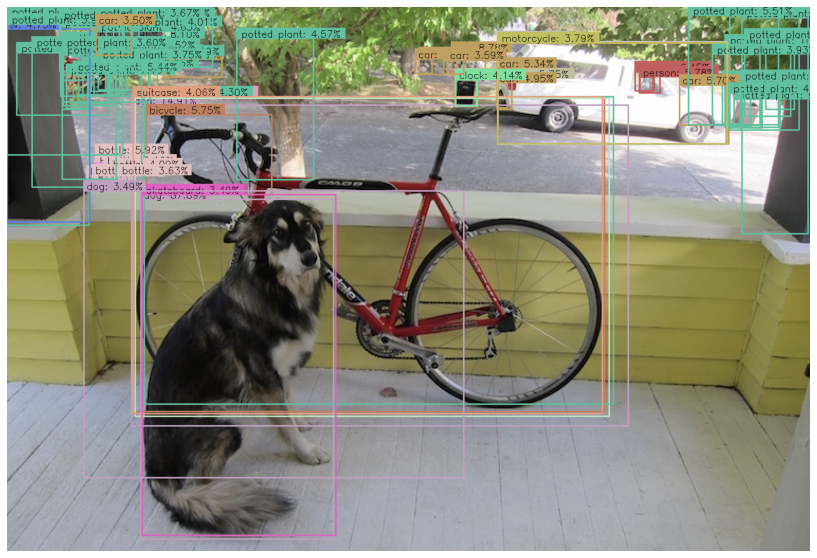

In [50]:
# Call the model.
results = od_model(images[0])

# Convert the dictionary values to numpy arrays.
results = {key:value.numpy() for key, value in results.items()}

# Remove the batch dimension from the first image.
image = np.squeeze(images[0])

# Process the first sample image.
img_bbox = process_detection(image, results, min_det_thresh=0)

plt.figure(figsize=[15, 10])
plt.imshow(img_bbox)
plt.axis('off');

##### 2.2.3.2 Display Results with min_det_thresh=0.3

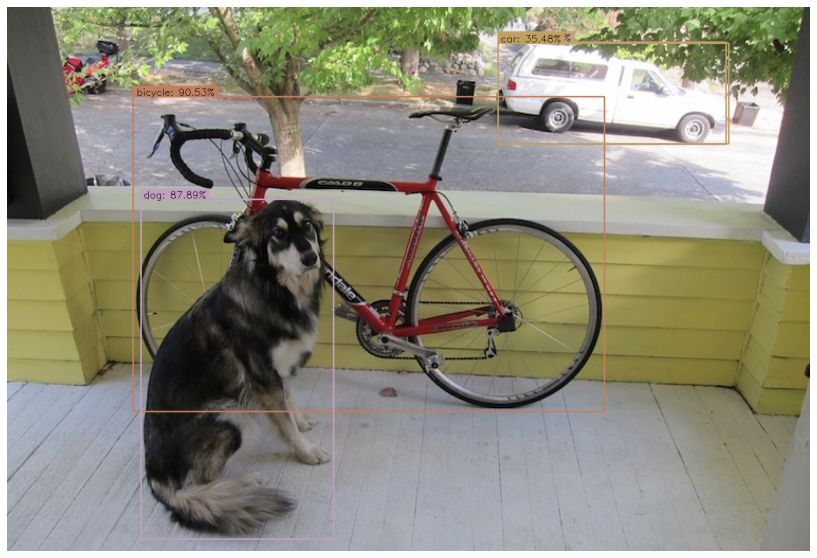

In [52]:
img_bbox = process_detection(image, results, min_det_thresh=.3)

plt.figure(figsize=[15, 10])
plt.imshow(img_bbox)
plt.axis('off');

## 3 Formalize the Implementation
In this section we will formalize the implementation and create a convenience function to execute the model on a list of images. As noted in the documentation, the models in this family do not support "batching." This means we need to call the model once for each image. But note that the input shape for the image does require a batch dimension.

### 3.1 `run_inference()`
`run_inference()` is a helper function that will call the model for each image in the list of images.

In [53]:
def run_inference(images, model):
    
    results_list = []
    for img in images:
        result = model(img)
        result = {key:value.numpy() for key,value in result.items()}

        results_list.append(result)

    return results_list

In [54]:
# Perform inference on each image and store the results in a list.
results_list = run_inference(images, od_model)

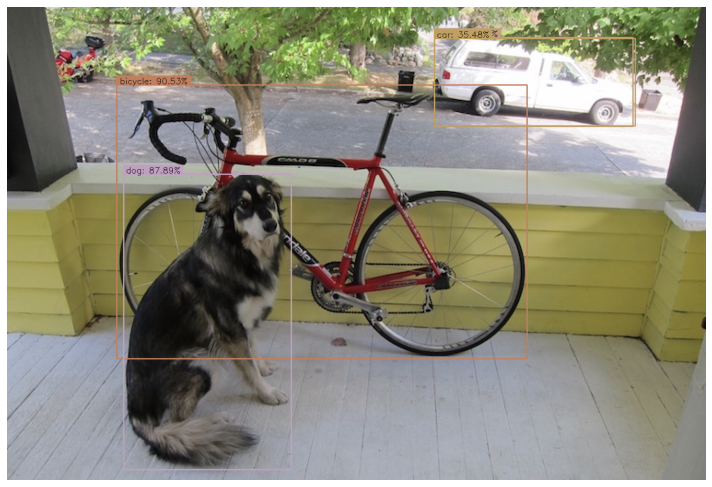

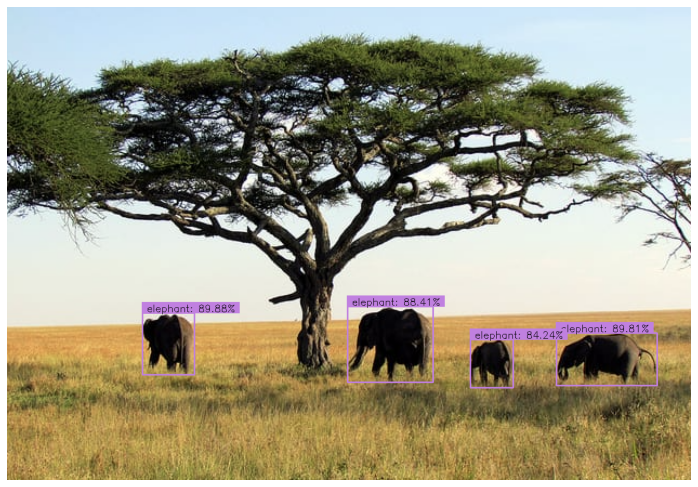

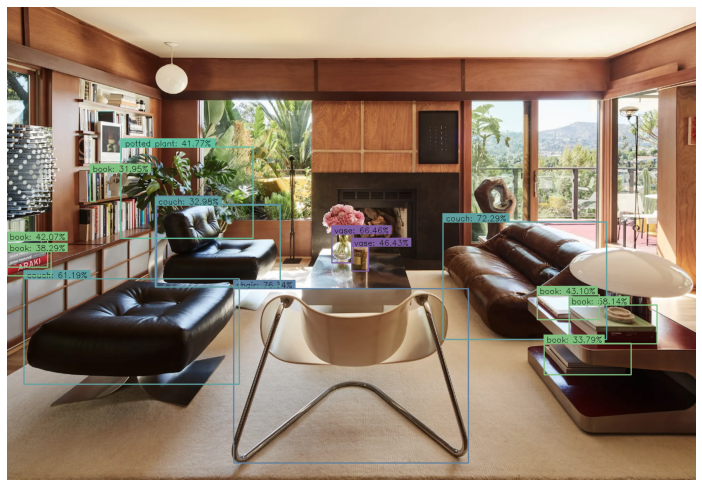

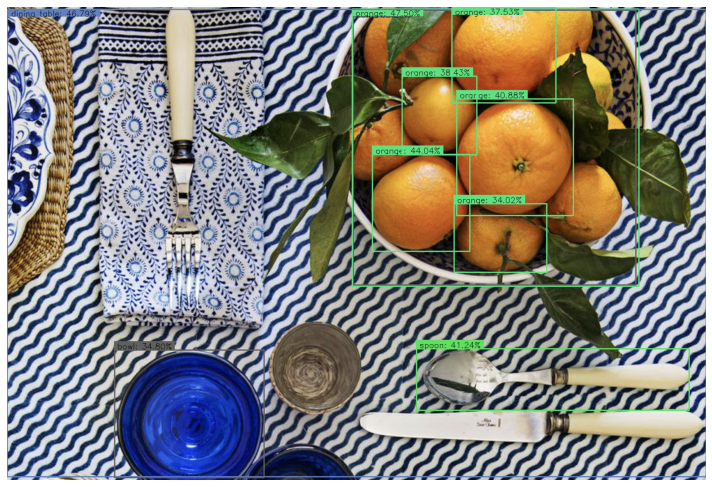

In [55]:
for idx in range(len(images)):
      
    # Remove the batch dimension.
    image = np.squeeze(images[idx])
    
    # Generate the annotated image.
    image_bbox = process_detection(image, results_list[idx], min_det_thresh=.31)
        
    # Display annotated image.
    plt.figure(figsize=[20,10*len(images)])
    plt.subplot(len(images),1,idx+1)
    plt.imshow(image_bbox)
    plt.axis('off')